In [2]:
import numpy as np
from Bio.PDB import PDBList
from pandas import DataFrame
import requests, json
import random
import os 
from biopandas.pdb import PandasPdb
import sys
from six.moves import urllib
from numba import jit,float32
from pathlib import Path
from matplotlib import pyplot as plt
import plotly.graph_objects as go
import pandas as pd
import urllib
import csv as cs
import shutil as sht
import glob as gbl
import warnings
from IPython.display import display, Markdown
import py3Dmol
warnings.filterwarnings("ignore")

# Protein automatic classification using Gauss integral 
- Lucia Depaoli
- Alessandro Fella
- Lorenzo Mandolito
- Simone Mistrali
   
   
   
    

## Introduction


Classify structure of proteins is an important task in biology. In particoular the secondary structure of a protein is determined by the geometric distribution of the amino acid residues. There are $2$ main secondary structures:





# <center>Alpha Helix</center>


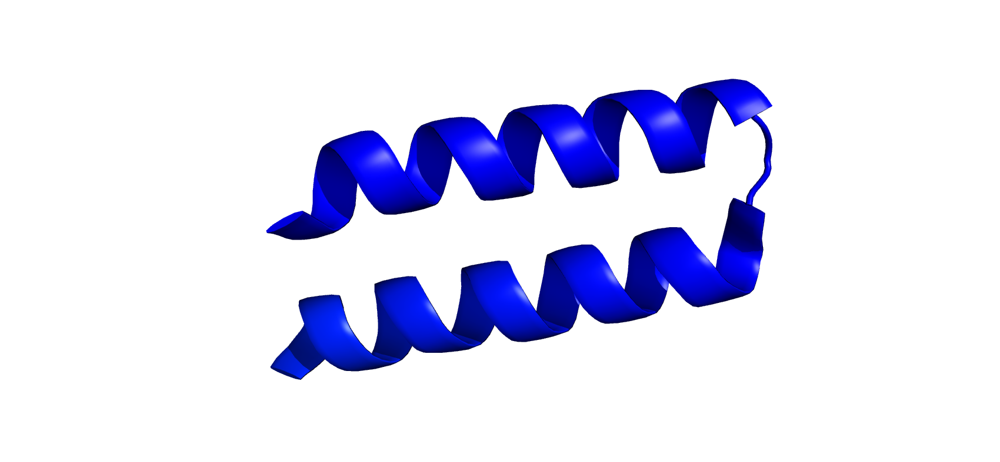
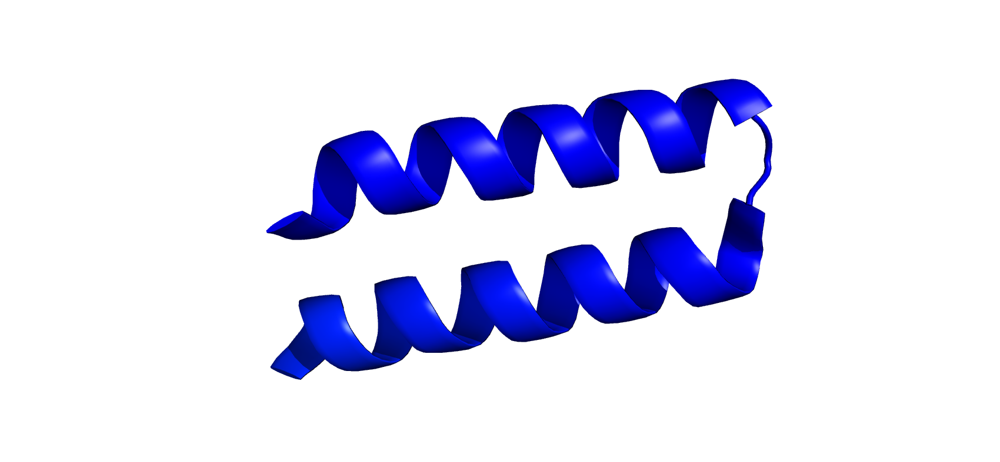

# <center>Beta Sheet</center>

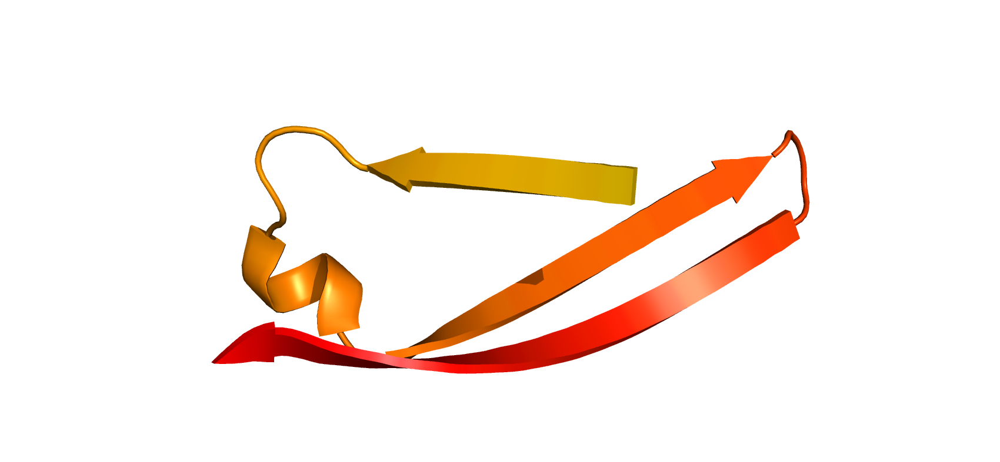
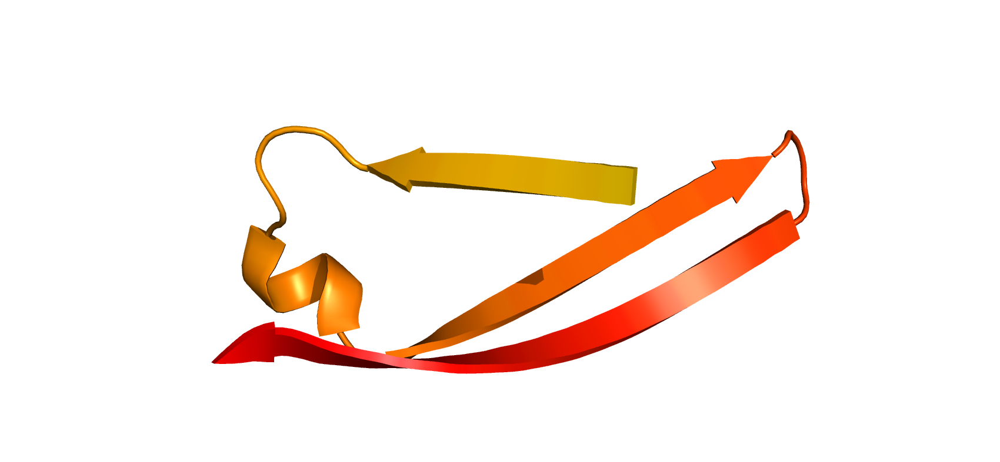

The chain of the carbon atoms $\{C_{\alpha}\}_{\alpha = 1 \dots N}$ (where $N$ is the length of the protein), is the backbone of the spatial structure of the protein.
In this work we try to classify the structure of $125833$ proteins ($73772$ after a `𝜎 clipping`). We get the coordinations of the $C_{\alpha}$ from the [Protein Data Bank (PDB)](https://www.rcsb.org/) downloading the `.pdb` files and cleaning it to get the $C_\alpha$s.



For our project we have followed the main idea of this paper: "[Automatic classification of protein structure by using
Gauss integrals](https://doi.org/10.1073/pnas.2636460100)" by Peter Røgen and Boris Fain, from now on we will refer to it as *PNAS* for simplicity.

We map the protein's geometry into a topological curve and compute the Writhe $W_r$.

 The Writhe of a curve $\gamma$ may be calculated via Gauss integral in this way:  

$$
W_r(\gamma) = \frac{1}{4\pi}\int \int_{\gamma \times \gamma\ D} \omega(t_1,t_2)\,dt_1\,dt_2 
$$

where $\omega(t_1,t_2)=\frac{\left[\gamma'(t_1),\gamma(t_1)-\gamma(t_2),\gamma'(t_2)\right]}{\left|\gamma(t_1)-\gamma(t_2) \right|^3}$, $D$ is the diagonal of $\gamma\times\gamma$ and $\left[\gamma'(t_1),\gamma(t_1)-\gamma(t_2),\gamma'(t_2)\right]$ the triple scalar product. 

As $\omega(t_1,t_2)=\omega(t_2,t_1)$ we can use this simpler formula:


$$
W_r(\gamma) = \frac{1}{2\pi}\int \int_{0<t_1<t_2<L} \omega(t_1,t_2)\,dt_1\,dt_2 
$$

We have a polygonal so we can use a more simple definition:

$$
W_r(\mu) = \sum _{0<i_1<i_2<N}W(i_1,i_2)
$$

with

$$
    W(i_1,i_2)=\frac{1}{2\pi}\int_{i_1=t_1}^{i_1+1}\int_{i_2=t_2}^{i_2+1}\omega(t_1,t_2)\,dt_1\,dt_2
$$


## PNAS Features

Following the *PNAS* we have computed a family of $14$ structural measures, they are computed as follows:

$$
I_{(1,2)}(\mu)= \sum _{0<i_1<i_2<N}W\left(i_1,i_2\right)
$$

$$
I_{|1,2|(3,5)}(\mu)= \sum_{0<i_1<i_2<i_3<i_5<N}\left|W(i_1,i_2)\right|W\left(i_3,i_5\right)\\
$$

# New Features

We propose a new kind of features whose computation is faster than the PNAS' ones. The calculations is based on a matrix of "nearest neighbor interaction", we compute the $\omega(t_1,t_2)$ only for the NN segments and then the definitions of the $I$-s are the same.

In this case the features are only local so they do not give an optimal representation of the whole protein, but only a local one.

# CATH

We follow the classification convention of the [CATH](https://www.cathdb.info/) database, every protein is classified with a number for its **C**lass, its **A**rchitecture,its **T**opology and its **H**omogous superfamily. 

In the next few slides we will show the division by class:
1. Mainly $\alpha$.
2. Mainly $\beta$.
3. Both $\alpha$ and $\beta$.
4. Few secondary structure.
6. Special.

In this case we show the proteins samples in and interactive and static way, because the interactive does not work on github.

The static images are produced via [Pymol](https://pymol.org/2/).

In [3]:
display(Markdown("<h1>Mainly 𝛼 </h1>"))
view = py3Dmol.view(query='pdb:4jhr',width=800, height=400) 
view.setStyle({'cartoon':{'color':'spectrum'}}) 
view.render()

<h1>Mainly 𝛼 </h1>

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

<h1>Mainly $\alpha$ </h1>

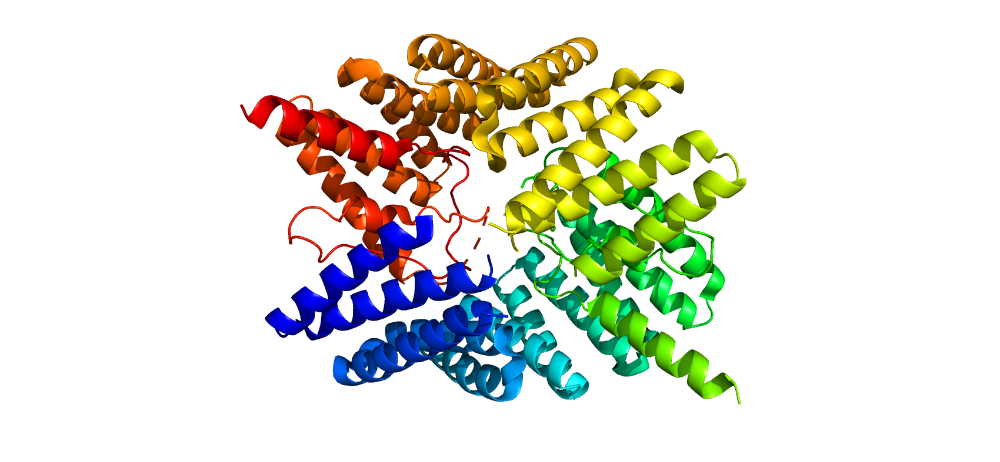

In [2]:
display(Markdown("<h1>Mainly 𝛽 </h1>")) 
view = py3Dmol.view(query='pdb:1py9',width=800, height=400) 
view.setStyle({'cartoon':{'color':'spectrum'}}) 
view.render()

<h1>Mainly 𝛽 </h1>

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

<h1>Mainly $\beta$ </h1>

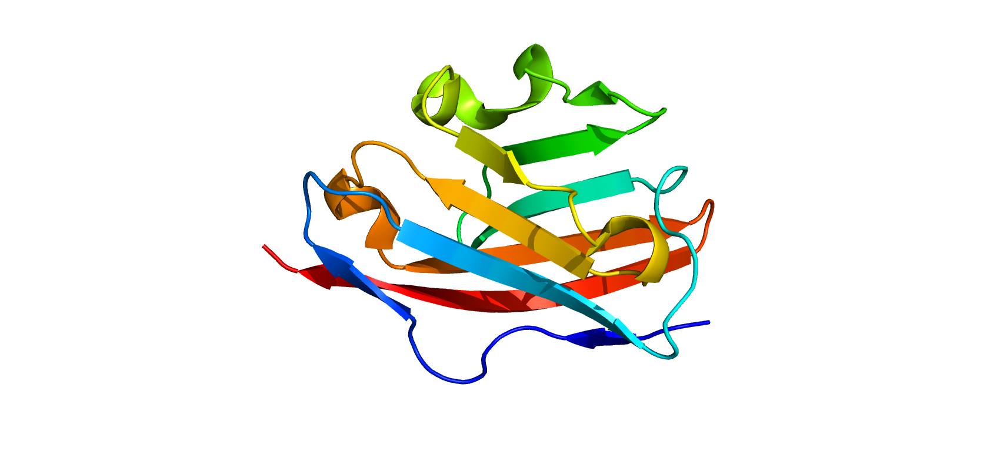

In [4]:
display(Markdown("<h1>Both 𝛼 and 𝛽</h1>"))
view = py3Dmol.view(query='pdb:117e',width=800, height=400) 
view.setStyle({'cartoon':{'color':'spectrum'}}) 
view.render()

<h1>Both 𝛼 and 𝛽</h1>

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

<h1>Both $\alpha$ and $\beta$ </h1>

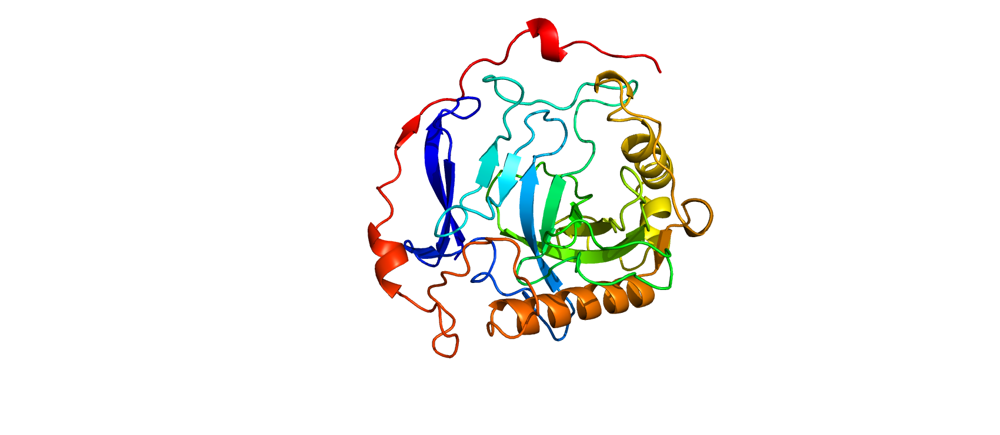

In [2]:
with open("./proteins_pymol/2py5A06_4.pdb") as ifile:
    system = "".join([x for x in ifile])

In [6]:
display(Markdown("<h1>Few secondary structure</h1>")) 
view = py3Dmol.view(width=800, height=400)
view.addModelsAsFrames(system)
view.setStyle({'cartoon':{'color':'spectrum'}}) 
view.render()

<h1>Few secondary structure</h1>

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

In [8]:
with open("./proteins_pymol/3lczA00_6.pdb") as ifile:
    system = "".join([x for x in ifile])

<h1>Few secondary structure</h1>

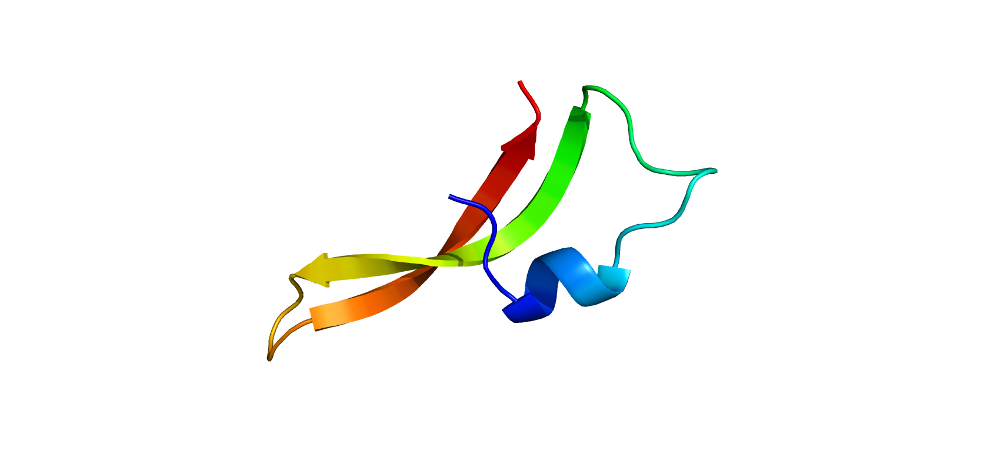

In [9]:
display(Markdown("<h1>Special</h1>")) 
view = py3Dmol.view(width=800, height=400)
view.addModelsAsFrames(system)
view.setStyle({'cartoon':{'color':'spectrum'}}) 
view.render()

<h1>Special</h1>

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

<h1>Special </h1>

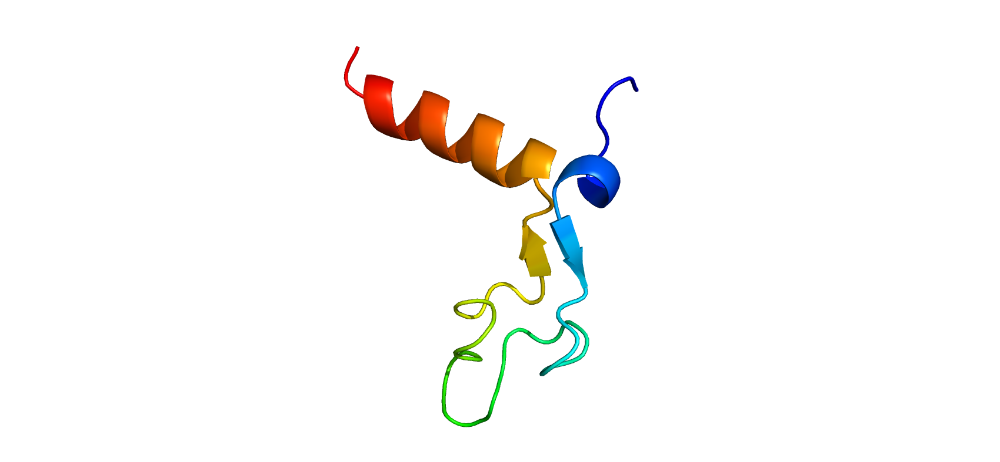

The project is divided in three sub-parts:

- Download the `.pdb` files of the proteins, separate it in the chains and compute the features.
- Clustering using `KNeighborsClassifier` and `DBSCAN`.
- Classification via neural networks.


## Download and cleaning of the `.pdb` files

In [3]:
# Using to define labels and to download the proteins

df = pd.read_csv("./CATH/cath-domain-list.txt",skiprows=16,names=["CATH_ID","Class_Number","Architecture_number","Topology_number","Homologous_superfamily_number",
                                                    "S35","S60","S95","S100_number","S100_count","Domain_length","resolution"],delim_whitespace=True)
df_new = df[df.resolution!=1000]
df_new["CATH_ID"] = df_new["CATH_ID"].map(lambda x: str(x)[:-3])
df_new = df_new.drop_duplicates("CATH_ID")
cath_id = np.array(df_new["CATH_ID"])
df_new = df_new.set_index(np.arange(0,len(cath_id)))

df_new=df_new.sort_values(by=['CATH_ID'],ignore_index=True)

In [ ]:
def download_pdb(pdbcode, datadir, downloadurl="https://files.rcsb.org/download/"):    
    pdbfn = pdbcode + ".pdb"
    url = downloadurl + pdbfn
    outfnm = os.path.join(datadir, pdbfn)
    try:
        urllib.request.urlretrieve(url, outfnm)
        return outfnm
    except:
        return None

In [ ]:
# Extract the x,y,z coordinates of the CA atoms for a given protein

def get_coord(x):

    try:
        ppdb = PandasPdb().fetch_pdb(x.lower())
        mainchain = ppdb.df['ATOM'][(ppdb.df['ATOM']['atom_name'] == 'CA')]

        a = mainchain[['x_coord', 'y_coord', 'z_coord']]

        N = len(a)
        coord = np.zeros((N,3))
        coord = np.array(a)

        return coord
    except AttributeError:
        return int(0)

## Missing $C_\alpha$ problem

The `.pdb` files (and also the data) are pretty messy, sometimes in the crystalization phase the protein doesn't properly crystalize, so some atoms are missing, to avoid this we decide to reject the proteins with more than $3$ missing $C_\alpha$. 



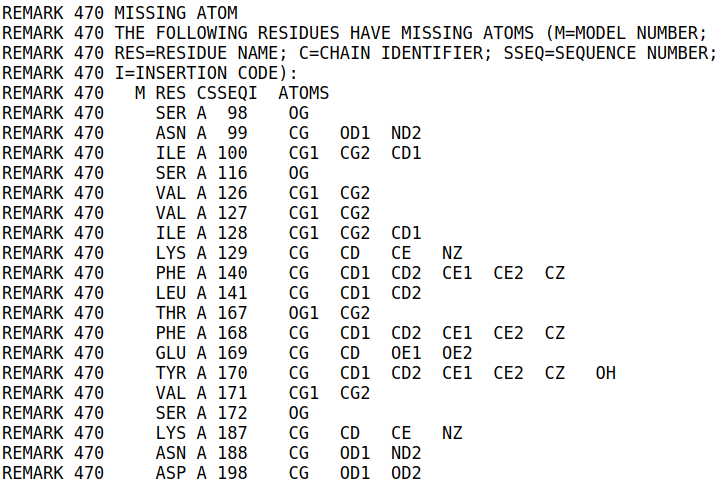
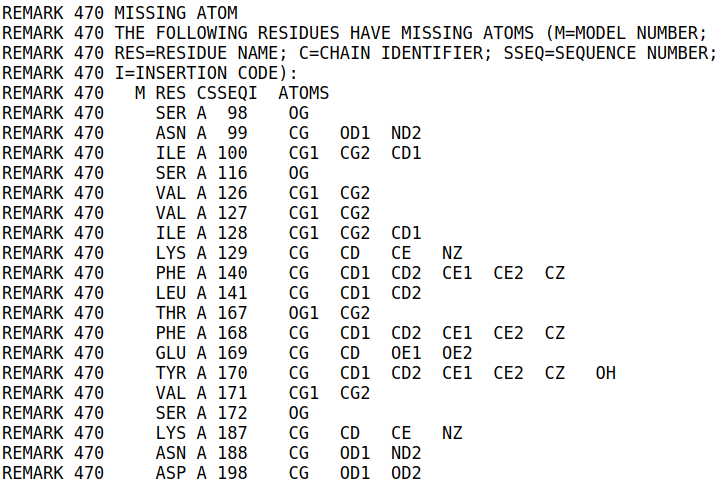

In [ ]:
# Reject a protein if the number of missing CA atoms is >3

def missing_atoms (inFile,h=3):

    """
    Input inFile-> PDB File, h-> How much missing CA you allowed?
    """
    c = 0
    FLAG = False
    # If j=TRUE the protein is ok
    j = True
    missing_atoms = [] 
    k = False
    for line in inFile:
        if FLAG==True and line.split()[1]=='470':
            k = True
            line[28:].replace('  ','   ')
            atoms = line[28:].split('   ')
            c += np.sum(np.char.count(atoms,"CA"))
        if ['REMARK','470'] != line.split(' ')[0:2]:
            FLAG = False
        if 'REMARK 470   M RES CSSEQI  ATOMS' == line.strip():
            FLAG = True
            atoms = []
        if c>h:
            j = False
            break
        
    return j

In [ ]:
# Get coord of a protein and save it in a txt file inside /prot_coord

def get_data(N):

    unique_numbers = np.sort(random.sample(range(0, len(df_new["CATH_ID"])),N+int(0.2*N)))
    c = 0
    cath_domain = []
    prot_name = []
    pdbl = PDBList()
    if not os.path.exists("./prot_coord/"):
        os.makedirs("./prot_coord/")
    np.sort(df_new["CATH_ID"])
    for i in unique_numbers:
        prot_name.append((df_new["CATH_ID"][i]).lower())
        j = df_new["CATH_ID"][i]

        download_pdb(j, 'PDB')
        flag = missing_atoms("PDB/" + j + ".pdb")
 
        if os.path.exists('./PDB/' + j + '.pdb') == True:
            os.remove("PDB/" + j + ".pdb")  
            
        if flag == True:
            coord = get_coord(j)
            if type(coord)!= int:
                np.savetxt("./prot_coord/" + j + '.txt', coord)
                c += 1
                a=f"{df_new['Class_Number'][i]}.{df_new['Architecture_number'][i]}.{df_new['Topology_number'][i]}.{df_new['Homologous_superfamily_number'][i]}"
                cath_domain.append(a)
        if (c == N):
            break
        

    return cath_domain

## Code optimization

In order to compute the invariant, we need fast and efficient computation, so we have rewrite some numpy function.

In [9]:
a = np.array([1,3,6])
b = np.array([5,8,9])
c = np.array([1,4,8])

print("Numpy's norm product")
%time np.linalg.norm(a)

print("\nOurs norm product")
%time dist(a)

print("\nNumpy's triple product")
%time np.linalg.det(np.dstack([a, b, c]))

print("\nOurs triple product")
%time tripleprod(a,b,c)

Numpy's norm product
CPU times: user 98 µs, sys: 8 µs, total: 106 µs
Wall time: 70.1 µs

Ours norm product
CPU times: user 9 µs, sys: 0 ns, total: 9 µs
Wall time: 11.2 µs

Numpy's triple product
CPU times: user 118 µs, sys: 10 µs, total: 128 µs
Wall time: 113 µs

Ours triple product
CPU times: user 6 µs, sys: 0 ns, total: 6 µs
Wall time: 7.63 µs


7

In [6]:
@jit(nopython=True)
def tripleprod(a,b,c):
    return a[0]*(b[1]*c[2]-b[2]*c[1])+a[1]*(b[2]*c[0]-b[0]*c[2])+a[2]*(b[0]*c[1]-b[1]*c[0])  

@jit(nopython=True)
def dist(a):
    return np.sqrt(a[1]**2 + a[0]**2 + a[2]**2)

@jit(nopython=True)
def writhe_matrix(M):

    N    = M.shape[0]
    W    = np.zeros((N-1,N-1))

    for i in range(N-1):
        dri  = M[i+1,:] - M[i,:]
        drih = 0.5*(M[i+1,:] + M[i,:])
        
        for j in range(i+1,N-1):
            drj = M[j+1,:] - M[j,:]
            drij = 0.5*(M[j+1,:] + M[j,:]) - drih
            
            v = tripleprod(dri,drij,drj)
            if(v!=0):
                k = dist(drij)
                k = k**3
                W[i,j] = v/k
    return W

@jit(nopython=True)
def create_I2(prot_coord):
    W = writhe_matrix(prot_coord)

    v = np.zeros(15)
    N = len(W)
    # Length of the protein
    v[0] = N+1

    for i in range(N-1):
        for j in range(i+2,N-1):
            v[1] += W[i,j]
            v[2] += abs(W[i,j])
            v[3] += W[i,i+1]*W[j,j+1]
            v[4] += abs(W[i,i+1])*W[j,j+1]
            v[5] += W[i,i+1]*abs(W[j,j+1])
            v[6] += abs(W[i,i+1]*W[j,j+1])
    for i in range(N-2):
        for j in range(i+3,N-2):

            v[7] += W[i,i+2]*W[j,j+2]
            v[8] += abs(W[i,i+2])*W[j,j+2]
            v[9] += W[i,i+2]*abs(W[j,j+2])
            v[10] += abs(W[i,i+2]*W[j,j+2])
    for i in range(N-3):
        for j in range(i+1,N-1):
            v[11] += W[i,i+3]*W[j,j+1]
            v[12] += abs(W[i,i+3])*W[j,j+1]
            v[13] += W[i,i+3]*abs(W[j,j+1]) 
            v[14] += abs(W[i,i+3]*W[j,j+1])
    v[1:2] /=v[0]   
    v[3:N-1] /= v[0]**2
    return v

In [ ]:
directory = "./prot_coord/"
dirout = "./coord_done/"
files = sorted(glb.glob(directory + '*'))
N_prot = len([name for name in os.listdir(directory)])
cath_file = open("./labels.txt","r")
cath_lines = cath_file.readlines()
cath_domain = []
for i in range(len(cath_domain)):
    cath_domain.append(cath_domain[i][:-1])

k=0
 
for i in files:
    if True:
        f = open("./coord_prot.txt","a")
        csvwriter = cs.writer(f) 
        prot_coord = np.genfromtxt(i,delimiter=' ')
        v = create_I2(prot_coord)
        xx = np.append(v,i[-8:-4])
        vector = np.append(xx, cath_domain[k])
        if os.path.exists('prot_coord/' + i[-8:-4]+ '.txt') == True:
            sht.move("prot_coord/"+i[-8:-4]+ ".txt",dirout)
        csvwriter.writerow(vector)
        f.close()
        k +=1

### Check the features with some simple geometrical shapes


In [12]:
# Straight line

n = 1000
t_max = 16 * np.pi
t = np.linspace(0, t_max, n)

line = np.zeros((n,3))
line[:,0]=t
line[:,1]=t
line[:,2]=t

v_1=create_I2(line)
v_1

array([1000.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
          0.,    0.,    0.,    0.,    0.,    0.])

In [13]:
# Helix

num = [100,150, 200, 300, 500, 750, 1000, 1700, 2000, 3000, 5000, 7000, 10000]
v = []
for i in num:
    t = np.linspace(0, t_max, i) 

    x = np.cos(t)
    y = np.sin(t)
    z = t

    helix = np.zeros((i,3))
    helix[:,0]=x[:]
    helix[:,1]=y[:]
    helix[:,2]=z[:]
    helix
    v1=create_I2(helix)
    v.append(v1[2])

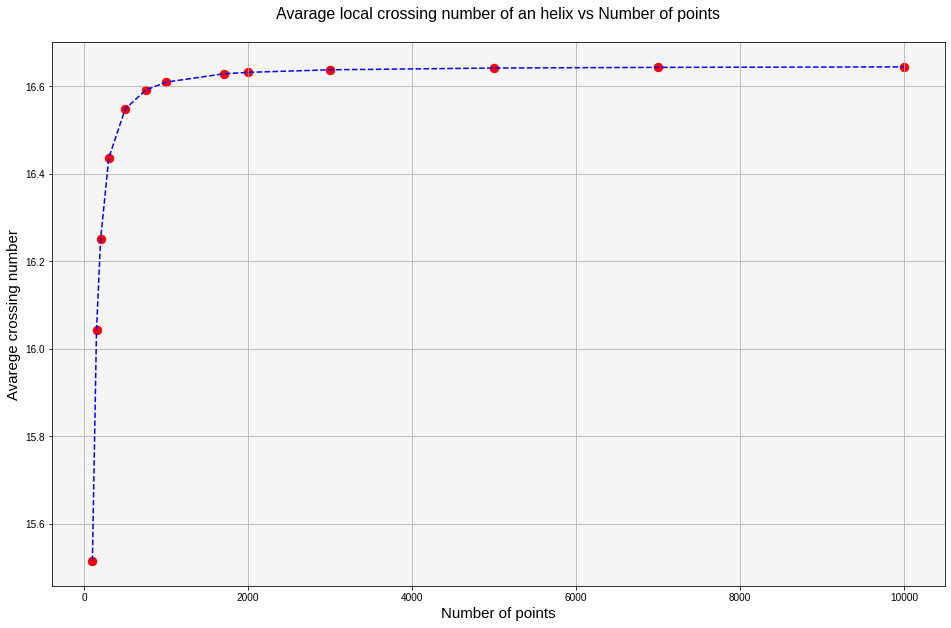

In [14]:
plt.figure(figsize=(16,10))

ax =plt.axes()
ax.set_facecolor("whitesmoke")
plt.plot(num, v,"--b")
plt.scatter(num, v, s = 70, c = "red")
plt.title("Avarage local crossing number of an helix vs Number of points\n", fontsize = 16)
plt.style.use('seaborn-ticks')
plt.xlabel("Number of points",fontsize=15)
plt.ylabel("Avarege crossing number",fontsize=15)
plt.grid()
plt.show()

# Clustering

We want to see if the features we have defined make the chains of the protein separate naturally into clusters. We perform a `DBSCAN` clustering on our data, previously projected into 2D and 3D plane using `t-SNE`.

In [2]:
'''Importing Data'''

y = np.loadtxt('labels.txt', dtype = str)
path = 'coord_prot.txt'
prot = pd.read_csv(path, header=None)
prot['label'] = y
prot = prot.sort_values(by=['label'],ignore_index=True)
prot = prot.dropna()
prot = prot[prot.label != 'nan']

x = prot[prot.columns[0:15]]
x = np.array(x)
y = prot['label']
y = np.array(y)

## Data processing

We clean the data in order to neglect some outliers. 

Plotting each feature for each chain, we can see that there are some points that have an extreme order of magnitude w.r.t. the typical order of magnitude of that feature.

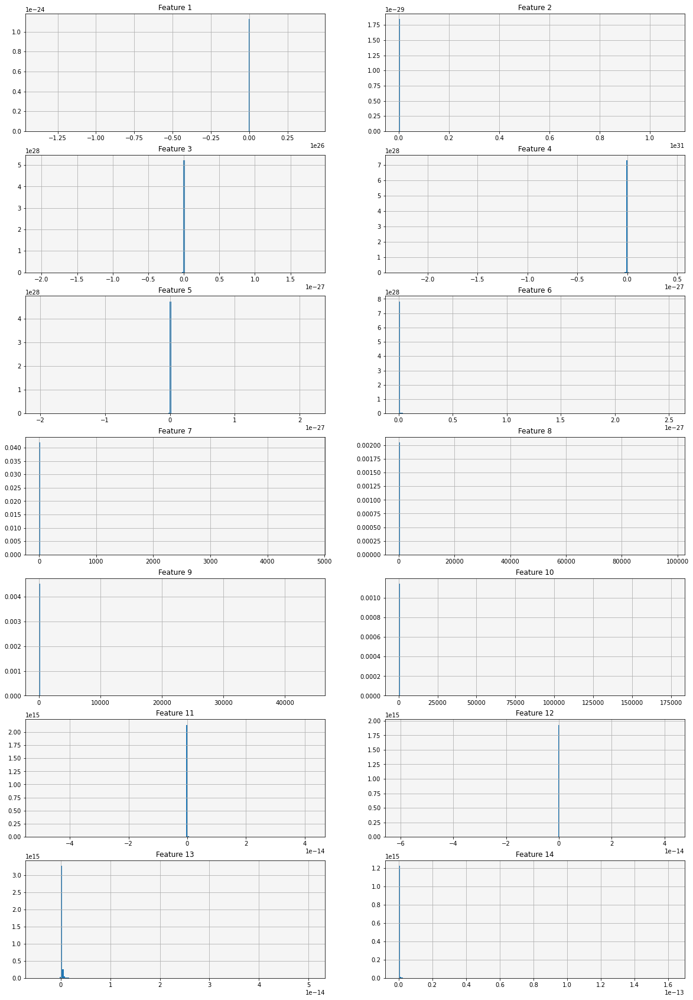

In [3]:
fig, axes = plt.subplots(7,2,figsize=(20,30))
k = 0
l = 0
for i in range(1,15):
    axes[l,k].set_title("Feature %d" %i)
    axes[l,k].set_facecolor("whitesmoke") 
    pos = i
    axes[l,k].hist(x[:,pos], bins = 200, density = True)
    axes[l,k].grid()
    k += 1
    if k != 0 and k %2== 0:
        l += 1
        k  = 0

Using the `sigma_clip` module for each them, the algorithm reject values that are less or more than a specified number of standard deviations (**3**) from the center value.

In [4]:
'''Cleaning Data'''

x = sigma_clip(x, sigma=3, masked=False, axis=0)
y = y[~np.isnan(x).any(axis=1)]
x = x[~np.isnan(x).any(axis=1)]

print("X shape after truncation: ", x.shape) 
print("y shape after truncation: ", y.shape)

X shape after truncation:  (73772, 15)
y shape after truncation:  (73772,)


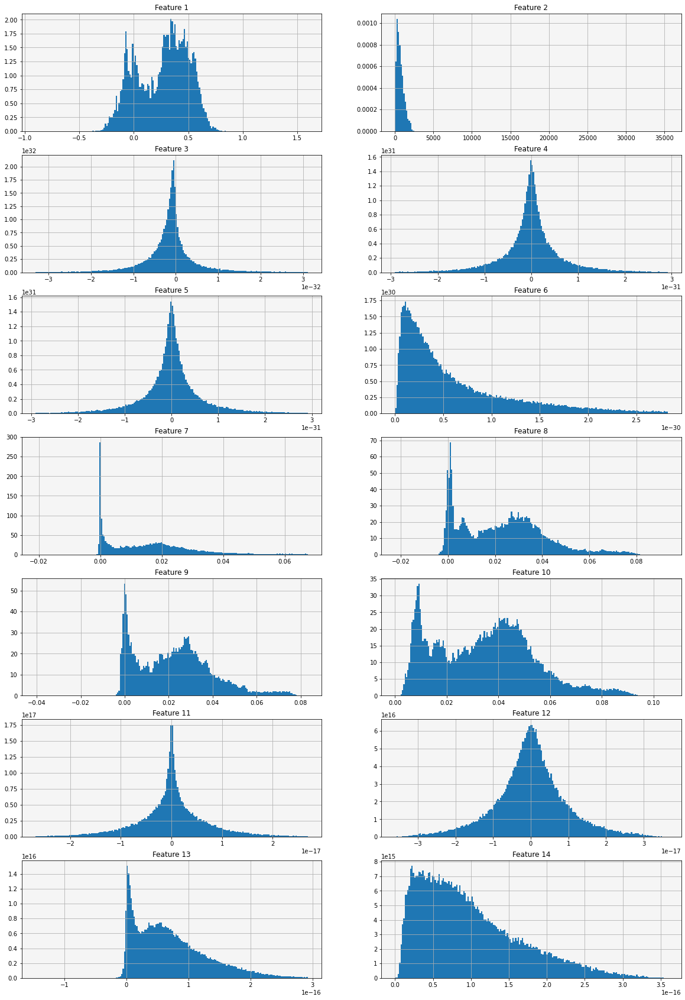

In [5]:
fig, axes = plt.subplots(7,2,figsize=(20,30))
k = 0
l = 0
for i in range(1,15):
    axes[l,k].set_title("Feature %d" %i)
    axes[l,k].set_facecolor("whitesmoke") 
    pos = i
    axes[l,k].hist(x[:,pos], bins = 200, density = True)
    axes[l,k].grid()
    k += 1
    if k != 0 and k %2== 0:
        l += 1
        k  = 0

We want to do a clustering for the C class, leaving out the $4$ and $6$ classes because they have very few samples.

Let's define our labels and the indices of the classes.

In [6]:
y_true = np.zeros(y.shape,dtype=int)
y = y[y != 'nan']
for i in range(len(y)):

    g = y[i].split('.')
    g = g[0]
    y_true[i] = int(g)

In [7]:
_, counts = np.unique(y_true, return_counts = True)
c1 = counts[0]
c2 = c1 + counts[1]
c3 = c2 + counts[2]
c4 = c3 + counts[3]
c6 = c4 + counts[4]

In [8]:
x_1 = x[:c3, :]
y_label = y_true[:c3]
uniqs, counts = np.unique(y_label,return_counts= True)
print("Labels in class C: ", uniqs)
print("Number of proteins in each label: ", counts)

Labels in class C:  [1 2 3]
Number of proteins in each label:  [14498 22318 36588]


`StandardScaler` transformation.

In [9]:
x_standard = StandardScaler().fit_transform(x_1)

### t-SNE in 2D

`t-SNE` in 2D with different values of perplexity. The best one result will be the input of the `DBSCAN`.

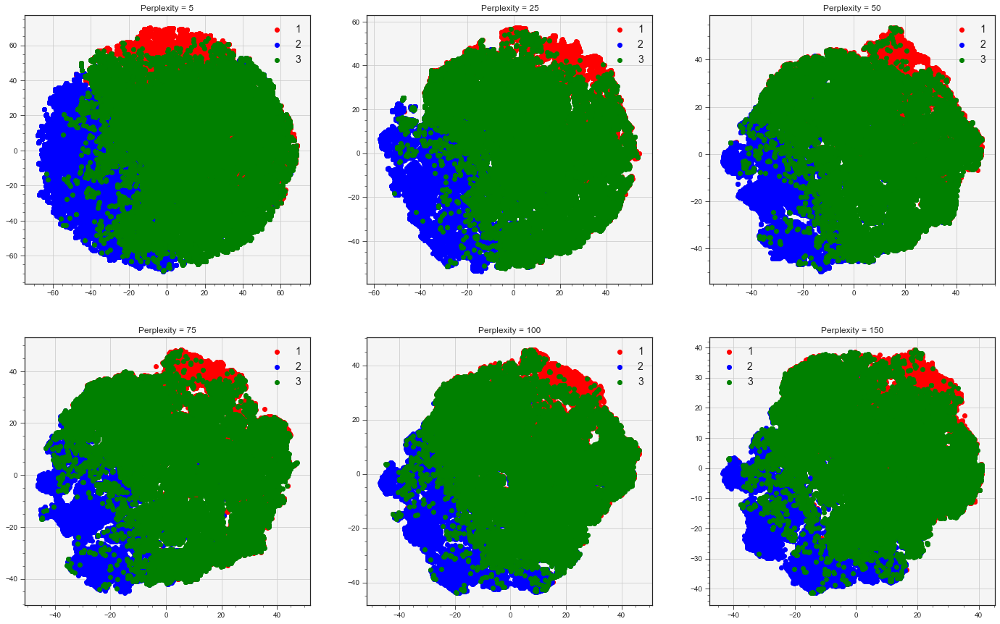

In [11]:
plt.style.use('seaborn-ticks')
perplexity=[5,25,50,75,100,150]
fig, axes =plt.subplots(2,3,figsize=(24,15))
k=0
j=0

for i in perplexity:
    data_embedded2D = skm.TSNE(n_components=2,perplexity=i,random_state=0).fit_transform(x_standard) 
    axes[j,k].scatter(data_embedded2D[:c1,0],data_embedded2D[:c1,1],label='1', c='red')
    axes[j,k].scatter(data_embedded2D[c1:c2,0],data_embedded2D[c1:c2,1],label='2', c='blue')
    axes[j,k].scatter(data_embedded2D[c2:,0],data_embedded2D[c2:,1],label='3', c='green') 
    axes[j,k].legend(fontsize=14,loc='best')
    axes[j,k].minorticks_on()
    axes[j,k].set_facecolor("whitesmoke")
    axes[j,k].grid()
    axes[j,k].set_title("Perplexity = " + str(i))
    
    k += 1
    if k!=0 and k%3==0:
        j += 1
        k  = 0

### t-SNE in 3D

Just for the interactive visualization.

In [34]:
data_embedded= skm.TSNE(n_components=3,perplexity=25,random_state=0).fit_transform(x_standard)

In [50]:
data_embedded = np.column_stack((data_embedded, y_label))

color = ['red', 'blue','green']
fig = go.Figure(data=[go.Scatter3d(
    x=data_embedded[:,0],
    y=data_embedded[:,1],
    z=data_embedded[:,2],
    mode='markers',
    marker=dict(
        size=2,
        color = data_embedded[:,3],
        colorscale = 'Viridis',   # choose a colorscale
        opacity = 0.8
    )
)])

fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

## DBSCAN

Working on the clipped-scaled data, we project them in 2 dimensions and we calculate the distance from each point to its closest two neighbours.
We plot the result and we find the optimal value for $\epsilon$ paramenter at the point of maximum curvature in the following plot.

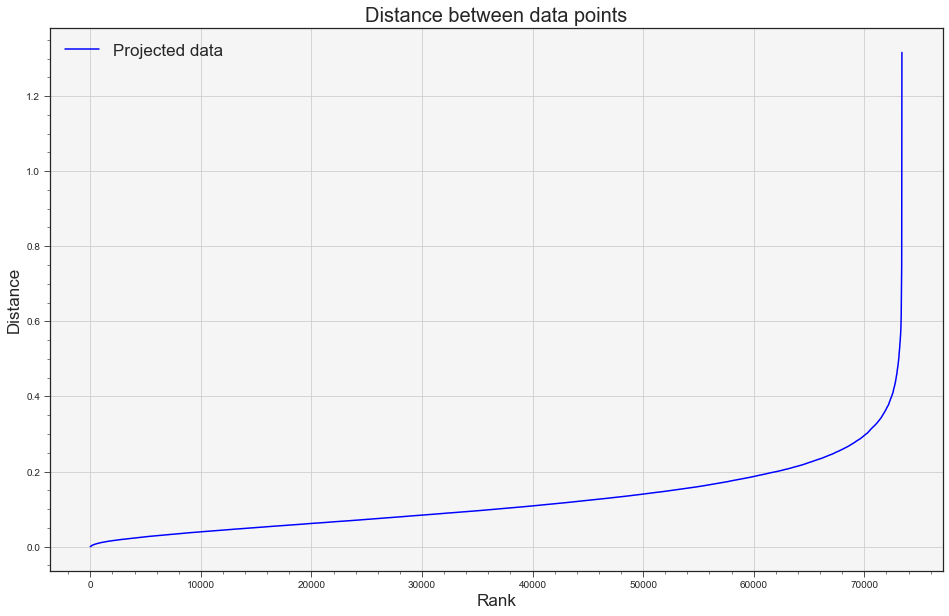

In [51]:
new_variable_scaled_lin = StandardScaler().fit_transform(x_1)
X = skm.TSNE(n_components=2,perplexity=25,random_state=0).fit_transform(new_variable_scaled_lin)

#Metric used: euclidean
#Number of neighbors assumed=2
neigh = NearestNeighbors(n_neighbors=3, metric="euclidean")

nbrs = neigh.fit(X)
distances, indices = nbrs.kneighbors(X)
distances = np.sort(distances, axis=0)
distances = distances[:,1]

plt.figure(figsize=(16,10))
plt.style.use('seaborn-ticks')
plt.minorticks_on()
plt.xlabel('Rank',fontsize=17)
plt.ylabel('Distance',fontsize=17)
plt.plot(distances, color='blue', label='Projected data')
ax = plt.axes()
ax.set_facecolor("whitesmoke")
plt.grid()
plt.title("Distance between data points", fontsize =20)
plt.legend(fontsize=17,loc="best")
plt.show()

In [52]:
cpalette = ["#1CE6FF", "#FF34FF", "#FF4A46","#008941", "#006FA6", "#A30059", "#0000A6", "#63FFAC","#B79762", "#004D43", "#8FB0FF", "#997D87","#5A0007", "#809693","#1B4400", "#4FC601", "#3B5DFF", "#4A3B53","#886F4C","#34362D", "#B4A8BD", "#00A6AA", "#452C2C","#636375", "#A3C8C9", "#FF913F", "#938A81","#575329", "#00FECF", "#B05B6F"]

def plotting_ax(X, y, ax):
    plt.style.use('seaborn-ticks')
    ax.set_facecolor("whitesmoke")
    # Plotting function
    for i, yu in enumerate(np.unique(y)):
        pos = (y == yu)   
        ax.minorticks_on()
        ax.scatter(X[pos,0], X[pos,1], c=cpalette[i%len(cpalette)], s=8)

def clustering(y):
    # Finds position of labels and returns a dictionary of cluster labels to data indices.
    yu = np.sort(np.unique(y))
    clustering = OrderedDict()
    for ye in yu:
        clustering[ye] = np.where(y == ye)[0]
    return clustering

def entropy(c, n_sample):
    # Measures the entropy of a cluster
    h = 0.
    for kc in c.keys():
        p = len(c[kc])/n_sample
        h += p*np.log(p)
    h *= -1.
    return h
    
def NMI(y_true, y_pred):
    # Computes normalized mutual information: where y_true and y_pred are both clustering assignments
    w = clustering(y_true)
    c = clustering(y_pred)
    n_sample = len(y_true)

    Iwc = 0.
    for kw in w.keys():
        for kc in c.keys():
            w_intersect_c = len(set(w[kw]).intersection(set(c[kc])))
            if w_intersect_c > 0:
                Iwc += w_intersect_c*np.log(n_sample*w_intersect_c/(len(w[kw])*len(c[kc])))
    Iwc /= n_sample
    Hc = entropy(c,n_sample)
    Hw = entropy(w,n_sample)
    return 2*Iwc/(Hc+Hw)

Let's perform a `DBSCAN` on the dataset to see if the features make the chains separate into $3$ clusters based on the density.

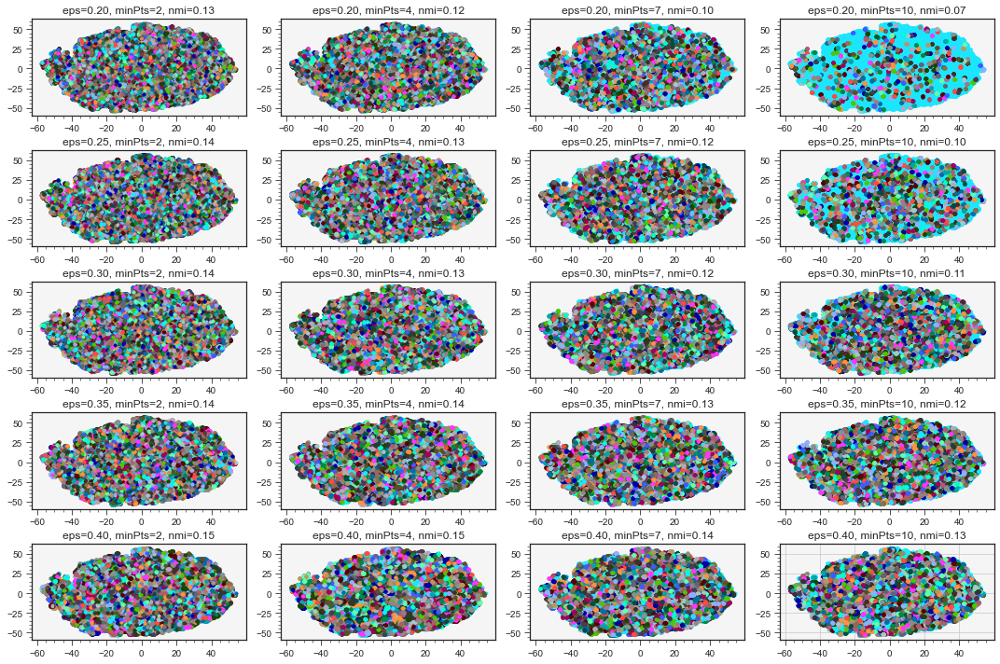

In [61]:
eps_range = [0.2,0.25,0.3,0.35,0.4]
min_sample_range = [2,4,7,10]

fig, ax = plt.subplots(len(eps_range),len(min_sample_range),figsize=(15,10))
for i, eps in enumerate(eps_range):
    for j, min_samples in enumerate(min_sample_range):
        ax[i,j].set_facecolor("whitesmoke")
        plt.style.use('seaborn-ticks')
        model = DBSCAN(eps=eps, min_samples=min_samples)
        model.fit(X)
        y_fake = model.labels_
        plotting_ax(X,y_fake,ax[i,j])
        nmi = NMI(y_fake, y_label)
        n_clusters_ = len(set(y_fake)) - (1 if -1 in y_fake else 0)
        ax[i,j].set_title('eps=%.2f, minPts=%i, nmi=%.2f'%(eps,min_samples,nmi))
plt.tight_layout(h_pad=0.5)
plt.grid()
plt.show()

We can clearly see that `DBSCAN` algorithm does not work for our dataset. We have tried to explore different `eps_values` in the previous plots also changing the `min_samples` parameter.
Basically the algorithm is not able to recognize our clusters.

## KNeighborsClassifier

This is the best algorithm to classify the protein chains. Later we will show that this method reaches a very good score using the features of the original paper.

In [62]:
k = [1, 2, 3, 4, 5, 6,7,8,9]
# Size of the test set
size = 0.9

In [63]:
acc = []
split = np.linspace(0.1, 0.9, 9)

for ki in k:
    X_train, X_test, y_train, y_test = train_test_split(x_standard, y_label, test_size=size, random_state=4)

    # Train Model and Predict
    neigh = KNeighborsClassifier(n_neighbors = ki, weights= 'distance', algorithm = 'brute').fit(X_train,y_train)
    Pred_y = neigh.predict(X_test)
    acc.append(metrics.accuracy_score(y_test, Pred_y))

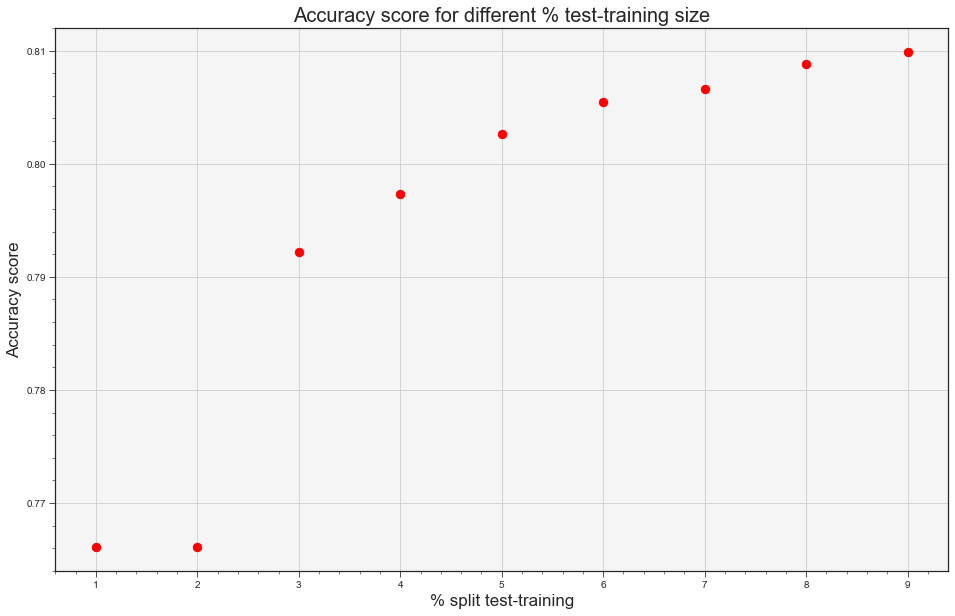

In [64]:
plt.figure(figsize=(16, 10))

plot=plt.scatter(k,acc, color="red", s = 70)
plt.xlabel('% split test-training',fontsize=17)
plt.style.use('seaborn-ticks')
plt.minorticks_on()
plt.ylabel('Accuracy score', fontsize=17)
ax = plt.axes()
ax.set_facecolor("whitesmoke")
plt.title('Accuracy score for different % test-training size',fontsize =20)
plt.grid()
plt.show()

# Classification KNeighborsClassifier

We have now implemented the classification of the original paper. In order to do this, we have computed the $15$ features using the C program used by authors of the paper.

What we want to utilize is a `KNeighborsClassifier`: we use a training set to compute the classifier, then we pick each point of the test set and his label will be the label of its nearest point ($k=1$).

## Data processing

Cleaning data using sigma clipping method within $3 \sigma$. This allow us to delete the outlier of a Gaussian shape distribution.

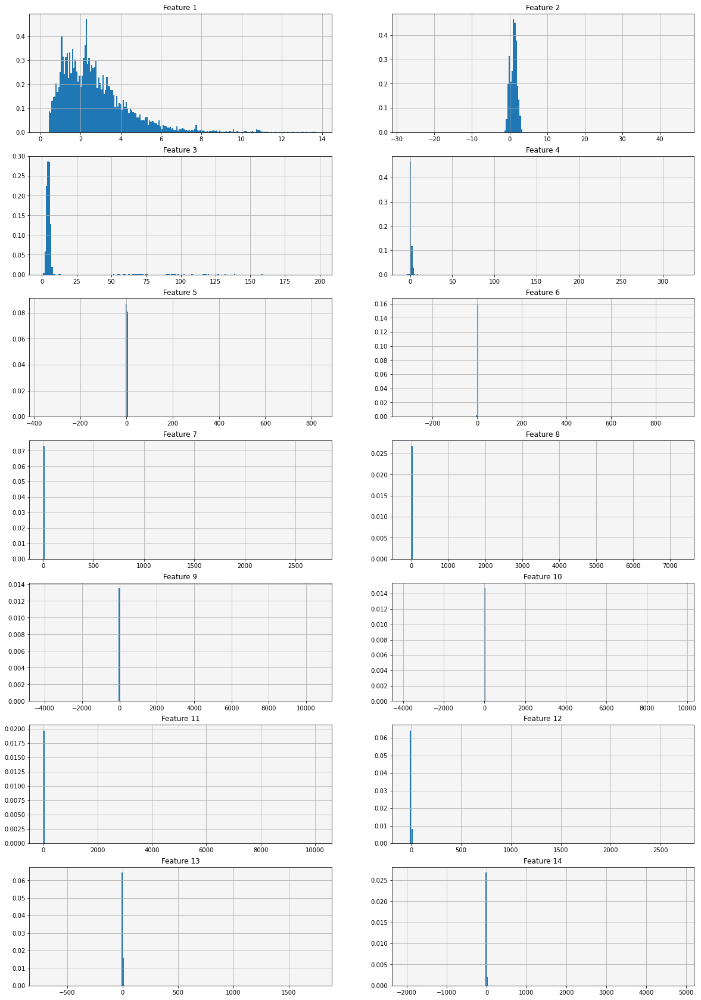

In [3]:
# Data before sigma clipping
fig, axes = plt.subplots(7,2,figsize=(20,30))
k = 0
l = 0
for i in range(1,15):
    axes[l,k].set_title("Feature %d" %i)
    axes[l,k].set_facecolor("whitesmoke") 
    pos = i
    axes[l,k].hist(x[:,pos], bins = 200, density = True)
    axes[l,k].grid()
    k += 1
    if k != 0 and k %2== 0:
        l += 1
        k  = 0

In [4]:
'''Cleaning Data'''

x = sigma_clip(x, sigma=3, masked=False, axis=0)
y = y[~np.isnan(x).any(axis=1)]
x = x[~np.isnan(x).any(axis=1)]


print("X shape after truncation: ", x.shape) 
print("y shape after truncation: ", y.shape)

X shape after truncation:  (56301, 15)
y shape after truncation:  (56301,)


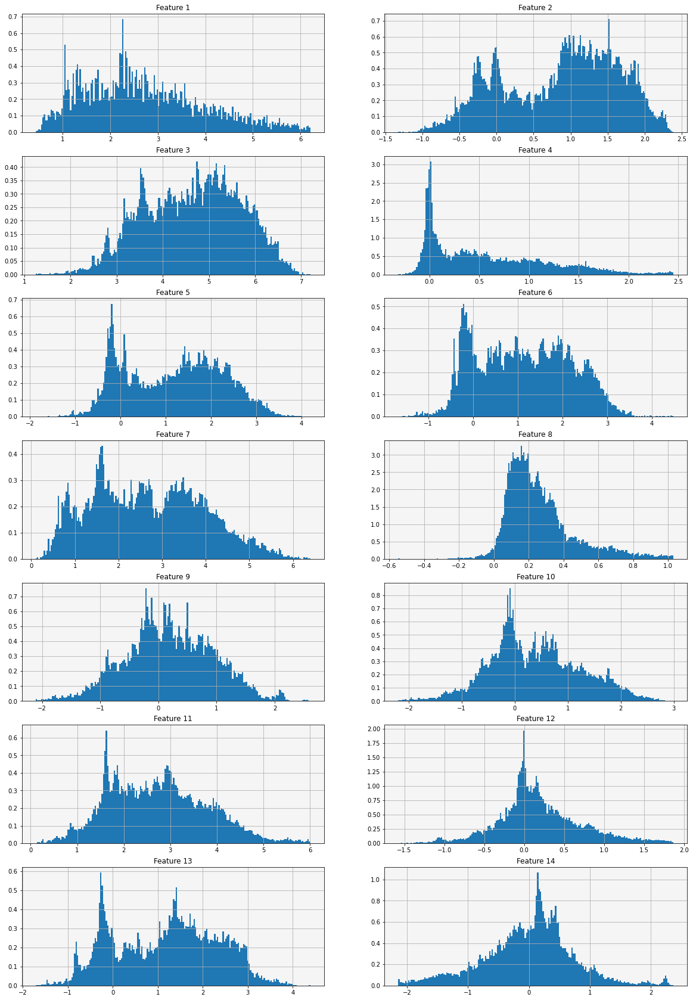

In [5]:
# Data after sigma clipping
fig, axes = plt.subplots(7,2,figsize=(20,30))
k = 0
l = 0
for i in range(1,15):
    axes[l,k].set_title("Feature %d" %i)
    axes[l,k].set_facecolor("whitesmoke") 
    pos = i
    axes[l,k].hist(x[:,pos], bins = 200, density = True)
    axes[l,k].grid()
    k += 1
    if k != 0 and k %2== 0:
        l += 1
        k  = 0

# Classification for the C class

Let's define the labels of our data. We want to cluster the **C** category, so we will have $5$ labels.

In [6]:
y_true = np.zeros(y.shape,dtype=int)
y = y[y != 'nan']
for i in range(len(y)):
    g = y[i].split('.')
    g = g[0]
    y_true[i] = int(g)
    
uniqs, counts = np.unique(y_true,return_counts= True)
print('X shape: ',x.shape)
print("Labels in class C: ", uniqs)
print("Number of proteins in each label: ", counts)

X shape:  (56301, 15)
Labels in class C:  [1 2 3 4 6]
Number of proteins in each label:  [11059 16507 28566   130    39]


In [7]:
# Class indices
_, counts = np.unique(y_true, return_counts = True)
c1 = counts[0]
c2 = c1 + counts[1]
c3 = c2 + counts[2]
c4 = c3 + counts[3]
c6 = c4 + counts[4]

We decided to perform a `StandardScaler` transformation on data because features have different range of values.

In [8]:
x_standard = StandardScaler().fit_transform(x)

### KNeighborsClassifier $k = 1$.

Each point find the nearest neighbors point and join its cluster.

In [9]:
k = 1
# Size of the test set
size = 0.5

We define a loop over the separation of training and test set. This is useful to show that, even if we select few training data, the protein chains naturally separates into fold clusters. So, once identified the cluster centers, the last and only step is to merge each chain into the cluster of the nearest point.

In [10]:
acc = []
split = np.linspace(0.1, 0.9, 9)

for sp in split:
    X_train, X_test, y_train, y_test = train_test_split(x_standard, y_true, test_size=sp, random_state=4)

    # Train Model and Predict
    neigh = KNeighborsClassifier(n_neighbors = k, weights= 'distance', algorithm = 'brute').fit(X_train,y_train)
    Pred_y = neigh.predict(X_test)
    acc.append(metrics.accuracy_score(y_test, Pred_y))

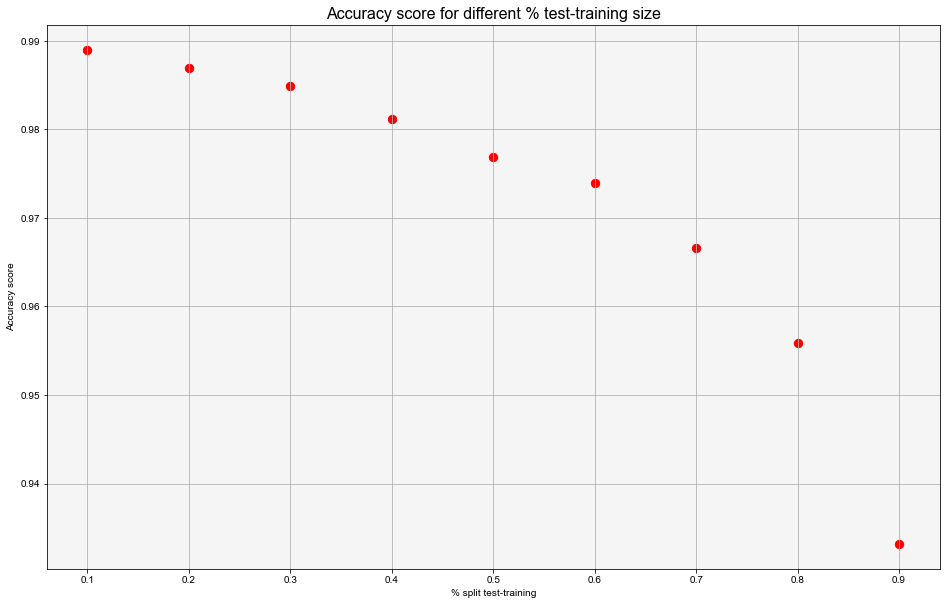

In [11]:
plt.figure(figsize=(16, 10))
font = {
        'size': 16,
        }
plot = plt.scatter(split,acc, color="red", s = 70)
plt.xlabel('% split test-training')
plt.ylabel('Accuracy score')
plt.title('Accuracy score for different % test-training size',fontdict=font)
ax = plt.axes()
plt.style.use('seaborn-ticks')
ax.set_facecolor('whitesmoke')
plt.grid()
plt.show()

We achieve a high score even with just $0.1$% of training size.

From now on, let's fix $0.5$% for the training size.

We show $2$ different Classifier. The first one is obtained using the original data (without scaling), while the second one is achieved using the scaled data.

In [12]:
X_train, X_test, y_train, y_test = train_test_split(x, y_true, test_size = size, random_state = 123)

# Train Model and Predict
neigh = KNeighborsClassifier(n_neighbors = k, weights = 'distance', algorithm = 'brute').fit(X_train, y_train)
Pred_y = neigh.predict(X_test)
print("Accuracy of model at K = 1 is",metrics.accuracy_score(y_test, Pred_y))

Accuracy of model at K = 1 is 0.9234840680615254


In [13]:
X_train, X_test, y_train, y_test = train_test_split(x_standard, y_true, test_size = size, random_state = 123)

# Train Model and Predict
neigh = KNeighborsClassifier(n_neighbors = k, weights = 'distance', algorithm = 'brute').fit(X_train, y_train)
Pred_y = neigh.predict(X_test)
print("Accuracy of model at K = 1 is",metrics.accuracy_score(y_test, Pred_y))

Accuracy of model at K = 1 is 0.9799296650207808


The accuracy of the second model is higher. From now on we will use only the scaled data.

Let's see the results using `PCA` in $2$ and $3$ dimension. We will visualize only the test set and the predicted labels.

In [14]:
label_encoder = LabelEncoder()
color = label_encoder.fit_transform(Pred_y)

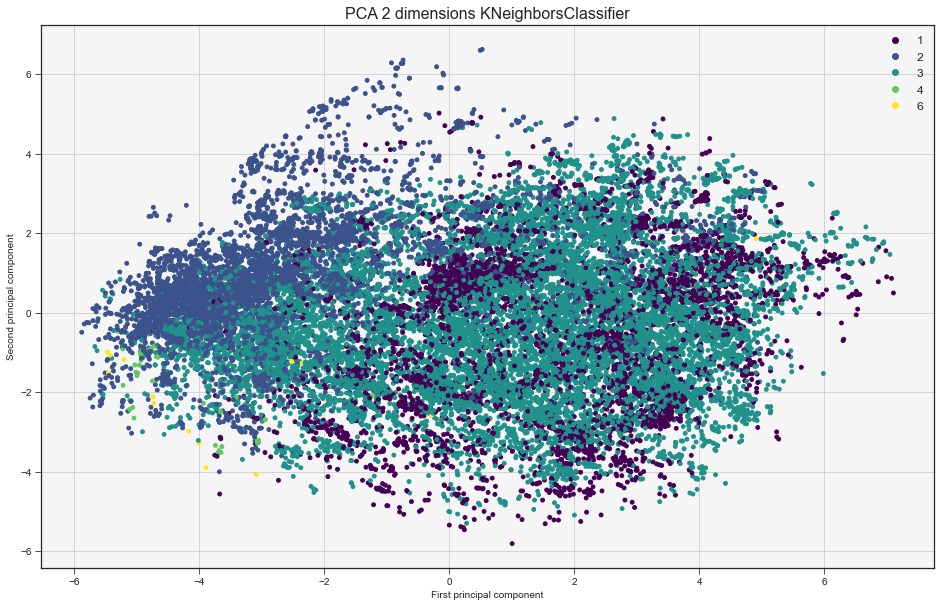

In [15]:
classes=list(np.unique(Pred_y))
font = {
        'size': 16,
        }

pca = PCA(n_components = 2)
pca_res = pca.fit_transform(X_test)

plt.figure(figsize=(16, 10))
plot=plt.scatter(pca_res[:, 0], pca_res[:, 1], c=color, s=15, cmap='viridis')
plt.xlabel('First principal component')
plt.ylabel('Second principal component')
plt.title('PCA 2 dimensions KNeighborsClassifier',fontdict=font)
# Produce a legend with the unique colors from the scatter
plt.legend(handles=plot.legend_elements()[0],labels=classes,loc="upper right",fontsize='12')
ax = plt.axes()
plt.style.use('seaborn-ticks')
ax.set_facecolor('whitesmoke')
plt.grid()
plt.show()


In [16]:
pca = PCA(n_components = 3)
data_embedded = pca.fit_transform(X_test)

fig = go.Figure(data=[go.Scatter3d(
    x=data_embedded[:,0],
    y=data_embedded[:,1],
    z=data_embedded[:,2],
    mode='markers',
    marker=dict(
        size=2,
        color = color,
        colorscale = 'Viridis',
        opacity = 0.7
    )
)])

fig.update_layout(scene = dict(
                    xaxis_title='First principal component',
                    yaxis_title='Second principal component',
                    zaxis_title='Third principal component'),
                    margin=dict(r=20, b=10, l=10, t=10))
fig.show()

# Classification for class A

Re-define the labels.

In [17]:
y_true = np.zeros(y.shape,dtype=int)
y = y[y != 'nan']

for i in range(len(y)):
    g = y[i].split('.')
    g = g[0] + g[1]
    y_true[i] = int(g)

##  $\alpha$ helix

In [18]:
x_1 = x[:c1,:]
y_label = y_true[:c1]
uniqs, counts = np.unique(y_label, return_counts= True)
print('X shape: ',x_1.shape)
print("Labels in class C = 1: ", uniqs)
print("Number of proteins in each label: ", counts)

x_standard = StandardScaler().fit_transform(x_1)

X shape:  (11059, 15)
Labels in class C = 1:  [110 120 125 150]
Number of proteins in each label:  [8613 2092  206  148]


### KNeighborsClassifier $k=1$.

In [19]:
X_train, X_test, y_train, y_test = train_test_split(x_standard, y_label, test_size = size, random_state = 123)

# Train Model and Predict
neigh = KNeighborsClassifier(n_neighbors = k, weights = 'distance', algorithm = 'brute').fit(X_train, y_train)
Pred_y = neigh.predict(X_test)
print("Accuracy of model at K = 1 is",metrics.accuracy_score(y_test, Pred_y))

Accuracy of model at K = 1 is 0.9714285714285714


Let's notice that, from now on, in the plot of the test set there could be less number of classes than the one printed above. This is because some classes have very few samples, so during the split of the dataset it is possible that all the sample went into the training set.

In [20]:
label_encoder = LabelEncoder()
color = label_encoder.fit_transform(Pred_y)

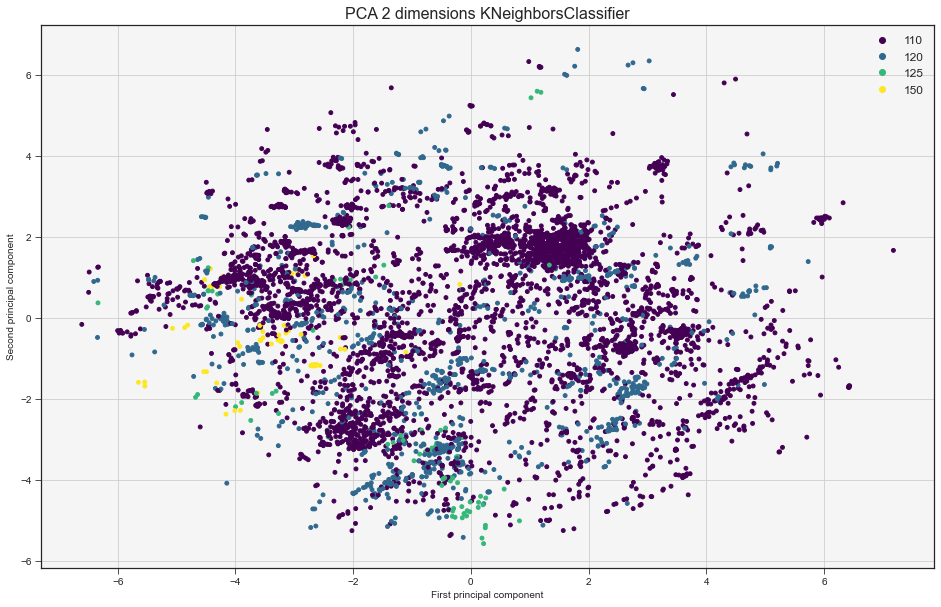

In [21]:
classes=list(np.unique(Pred_y))
font = {
        'size': 16,
        }

pca = PCA(n_components = 2)
pca_res = pca.fit_transform(X_test)

plt.figure(figsize=(16, 10))
plot=plt.scatter(pca_res[:, 0], pca_res[:, 1], c=color, s=15, cmap='viridis')
plt.xlabel('First principal component')
plt.ylabel('Second principal component')
plt.title('PCA 2 dimensions KNeighborsClassifier',fontdict=font)
plt.legend(handles=plot.legend_elements()[0],labels=classes,loc="upper right",fontsize='12')
ax = plt.axes()
plt.style.use('seaborn-ticks')
ax.set_facecolor('whitesmoke')
plt.grid()
plt.show()



In [22]:
pca = PCA(n_components = 3)
data_embedded = pca.fit_transform(X_test)

fig = go.Figure(data=[go.Scatter3d(
    x=data_embedded[:,0],
    y=data_embedded[:,1],
    z=data_embedded[:,2],
    mode='markers',
    marker=dict(
        size=2,
        color = color,
        colorscale = 'Viridis',
        opacity = 0.7
    )
)])

fig.update_layout(scene = dict(
                    xaxis_title='First principal component',
                    yaxis_title='Second principal component',
                    zaxis_title='Third principal component'),
                    margin=dict(r=20, b=10, l=10, t=10))
fig.show()

## $\beta$ sheet

In [23]:
x_1 = x[c1:c2,:]
y_label = y_true[c1:c2]
uniqs, counts = np.unique(y_label, return_counts= True)
print('X shape: ',x_1.shape)
print("Labels in class C = 2: ", uniqs)
print("Number of proteins in each label: ", counts)

x_standard = StandardScaler().fit_transform(x_1)

X shape:  (16507, 15)
Labels in class C = 2:  [ 210  220  230  240  250  260  270  280  290 2100 2102 2110 2115 2120
 2130 2140 2150 2160 2170]
Number of proteins in each label:  [ 713  218 1669 4322   18 7758  591  270   27   65   38   13   46  158
  225    8   10  205  153]


### KNeighborsClassifier $k=1$.

In [24]:
X_train, X_test, y_train, y_test = train_test_split(x_standard, y_label, test_size = size, random_state = 123)

# Train Model and Predict
neigh = KNeighborsClassifier(n_neighbors = k, weights = 'distance', algorithm = 'brute').fit(X_train, y_train)
Pred_y = neigh.predict(X_test)
print("Accuracy of model at K = 1 is",metrics.accuracy_score(y_test, Pred_y))

Accuracy of model at K = 1 is 0.9670462805912285


In [25]:
label_encoder = LabelEncoder()
color = label_encoder.fit_transform(Pred_y)

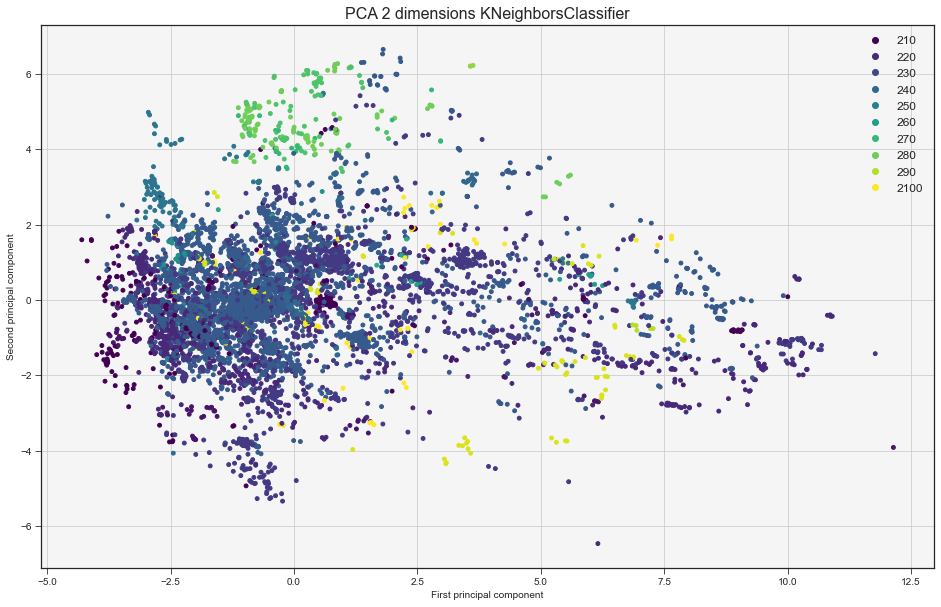

In [26]:
classes=list(np.unique(Pred_y))
font = {
        'size': 16,
        }

pca = PCA(n_components = 2)
pca_res = pca.fit_transform(X_test)

plt.figure(figsize=(16, 10))
plot=plt.scatter(pca_res[:, 0], pca_res[:, 1], c=color, s=15, cmap='viridis')
plt.xlabel('First principal component')
plt.ylabel('Second principal component')
plt.title('PCA 2 dimensions KNeighborsClassifier',fontdict=font)
plt.legend(handles=plot.legend_elements()[0],labels=classes,loc="upper right",fontsize='12')
ax = plt.axes()
plt.style.use('seaborn-ticks')
ax.set_facecolor('whitesmoke')
plt.grid()
plt.show()



In [27]:
pca = PCA(n_components = 3)
data_embedded = pca.fit_transform(X_test)

fig = go.Figure(data=[go.Scatter3d(
    x=data_embedded[:,0],
    y=data_embedded[:,1],
    z=data_embedded[:,2],
    mode='markers',
    marker=dict(
        size=2,
        color = color,
        colorscale = 'Viridis',
        opacity = 0.7
    )
)])

fig.update_layout(scene = dict(
                    xaxis_title='First principal component',
                    yaxis_title='Second principal component',
                    zaxis_title='Third principal component'),
                    margin=dict(r=20, b=10, l=10, t=10))
fig.show()

## $\alpha \beta$

In [28]:
x_1 = x[c2:c3,:]
y_label = y_true[c2:c3]
uniqs, counts = np.unique(y_label, return_counts= True)
print('X shape: ',x_1.shape)
print("Labels in class C = 3: ", uniqs)
print("Number of proteins in each label: ", counts)

x_standard = StandardScaler().fit_transform(x_1)

X shape:  (28566, 15)
Labels in class C = 3:  [ 310  315  320  330  340  350  355  360  365  370  375  380  390 3100]
Number of proteins in each label:  [ 2405     7  2702  6218 11889   295     8  2175    72    76    29    97
  2563    30]


### KNeighborsClassifier $k=1$.

In [29]:
X_train, X_test, y_train, y_test = train_test_split(x_standard, y_label, test_size = size, random_state = 123)

# Train Model and Predict
neigh = KNeighborsClassifier(n_neighbors = k, weights = 'distance', algorithm = 'brute').fit(X_train, y_train)
Pred_y = neigh.predict(X_test)
print("Accuracy of model at K = 1 is",metrics.accuracy_score(y_test, Pred_y))

Accuracy of model at K = 1 is 0.9730448785269201


In [30]:
label_encoder = LabelEncoder()
color = label_encoder.fit_transform(Pred_y)

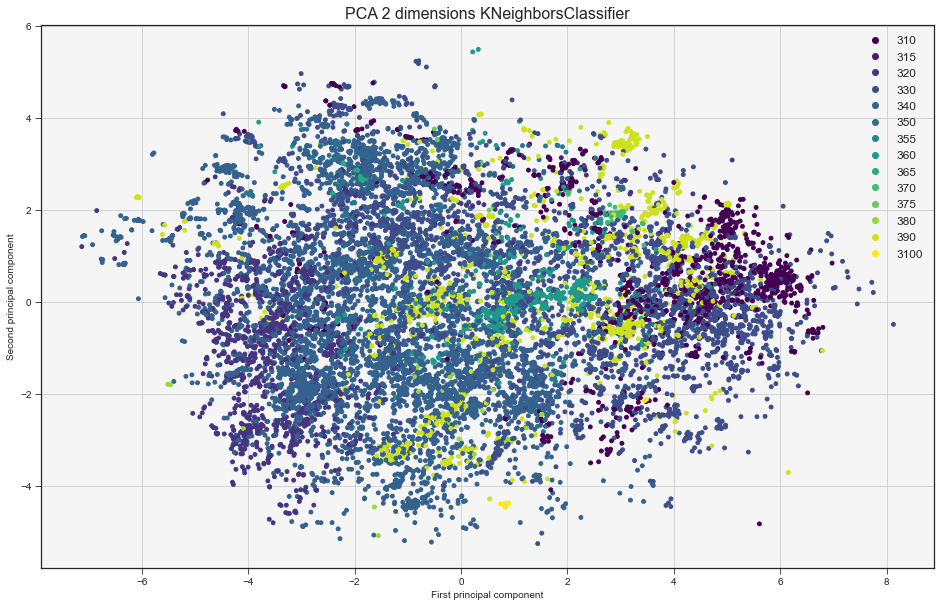

In [31]:
classes=list(np.unique(Pred_y))
font = {
        'size': 16,
        }

pca = PCA(n_components = 2)
pca_res = pca.fit_transform(X_test)

plt.figure(figsize=(16, 10))
plot=plt.scatter(pca_res[:, 0], pca_res[:, 1], c=color, s=15, cmap='viridis')
plt.xlabel('First principal component')
plt.ylabel('Second principal component')
plt.title('PCA 2 dimensions KNeighborsClassifier',fontdict=font)
plt.legend(handles=plot.legend_elements()[0],labels=classes,loc="upper right",fontsize='12')
ax = plt.axes()
plt.style.use('seaborn-ticks')
ax.set_facecolor('whitesmoke')
plt.grid()
plt.show()


In [32]:
pca = PCA(n_components = 3)
data_embedded = pca.fit_transform(X_test)

fig = go.Figure(data=[go.Scatter3d(
    x=data_embedded[:,0],
    y=data_embedded[:,1],
    z=data_embedded[:,2],
    mode='markers',
    marker=dict(
        size=2,
        color = color,
        colorscale = 'Viridis',
        opacity = 0.7
    )
)])

fig.update_layout(scene = dict(
                    xaxis_title='First principal component',
                    yaxis_title='Second principal component',
                    zaxis_title='Third principal component'),
                    margin=dict(r=20, b=10, l=10, t=10))
fig.show()

We just want to show that this method works even when we go inside each class. We won't do the classification T and H for all the categories, but just for one each, in order to show the common results.

# Classification for class T (110)

In [33]:
c1 = y_true[y_true == 110].shape[0]

y_true = np.zeros(c1,dtype=int)
y = y[y != 'nan']
for i in range(c1):
    g = y[i].split('.')
    g = g[0] + g[1] + g[2]
    y_true[i] = int(g)

In [34]:
x_1 = x[:c1,:]
y_label = y_true[:c1]
uniqs, counts = np.unique(y_label, return_counts= True)
print('X shape: ',x_1.shape)
print("Labels in class A = 110: ", uniqs)
print("Number of proteins in each label: ", counts)

x_standard = StandardScaler().fit_transform(x_1)

X shape:  (8613, 15)
Labels in class A = 110:  [   1108   11010   11012   11015   11020   11030   11040   11045   11060
  110101  110110  110132  110135  110140  110150  110155  110166  110167
  110168  110170  110210  110220  110225  110230  110238  110240  110245
  110246  110260  110268  110269  110274  110275  110285  110286  110287
  110288  110290  110300  110340  110357  110375  110390  110400  110405
  110418  110420  110437  110439  110440  110441  110442  110443  110455
  110468  110472  110489  110490  110506  110510  110520  110530  110533
  110540  110555  110560  110565  110575  110579  110590  110600  110606
  110620  110630  110640  110645  110700  110720  110730  110750  110760
  110780  110790  110800  110820  110840  110860  110890  110930  110950
 1101020 1101040 1101050 1101060 1101070 1101080 1101130 1101140 1101160
 1101170 1101200 1101220 1101240 1101280 1101300 1101350 1101370 1101390
 1101400 1101410 1101420 1101500 1101520 1101530 1101580 1101600 1101610
 110

### KNeighborsClassifier $k=1$.

In [35]:
X_train, X_test, y_train, y_test = train_test_split(x_standard, y_label, test_size = size, random_state = 123)

# Train Model and Predict
neigh = KNeighborsClassifier(n_neighbors = k, weights = 'distance', algorithm = 'brute').fit(X_train, y_train)
Pred_y = neigh.predict(X_test)
print("Accuracy of model at K = 1 is",metrics.accuracy_score(y_test, Pred_y))

Accuracy of model at K = 1 is 0.9445089389366148


In [36]:
label_encoder = LabelEncoder()
color = label_encoder.fit_transform(Pred_y)

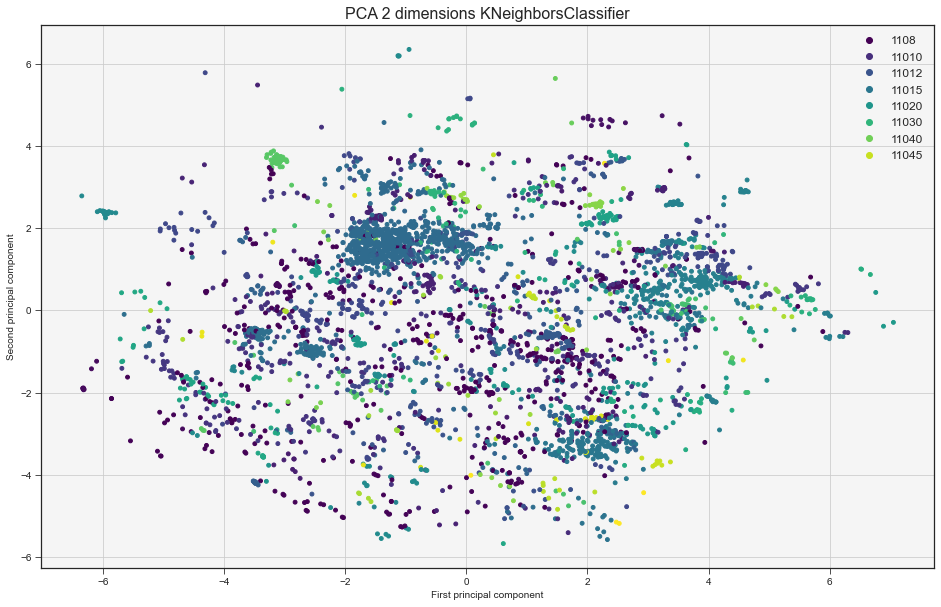

In [37]:
classes=list(np.unique(Pred_y))
font = {
        'size': 16,
        }

pca = PCA(n_components = 2)
pca_res = pca.fit_transform(X_test)

plt.figure(figsize=(16, 10))
plot=plt.scatter(pca_res[:, 0], pca_res[:, 1], c=color, s=15, cmap='viridis')
plt.xlabel('First principal component')
plt.ylabel('Second principal component')
plt.title('PCA 2 dimensions KNeighborsClassifier',fontdict=font)
plt.legend(handles=plot.legend_elements()[0],labels=classes,loc="upper right",fontsize='12')
ax = plt.axes()
plt.style.use('seaborn-ticks')
ax.set_facecolor('whitesmoke')
plt.grid()
plt.show()


In [38]:
pca = PCA(n_components = 3)
data_embedded = pca.fit_transform(X_test)

fig = go.Figure(data=[go.Scatter3d(
    x=data_embedded[:,0],
    y=data_embedded[:,1],
    z=data_embedded[:,2],
    mode='markers',
    marker=dict(
        size=2,
        color = color,
        colorscale = 'Viridis',
        opacity = 0.7
    )
)])

fig.update_layout(scene = dict(
                    xaxis_title='First principal component',
                    yaxis_title='Second principal component',
                    zaxis_title='Third principal component'),
                    margin=dict(r=20, b=10, l=10, t=10))
fig.show()

# Classification for class H (11010)

In [39]:
c1 = y_true[y_true == 11010].shape[0]

y_true = np.zeros(c1,dtype=int)
y = y[y != 'nan']
for i in range(c1):
    g = y[i].split('.')
    g = g[0] + g[1] + g[2] + g[3]
    y_true[i] = int(g)

In [40]:
x_1 = x[:c1,:]
y_label = y_true[:c1]
uniqs, counts = np.unique(y_label, return_counts= True)
print('X shape: ',x_1.shape)
print("Labels in class T = 11010: ", uniqs)
print("Number of proteins in each label: ", counts)

x_standard = StandardScaler().fit_transform(x_1)

X shape:  (631, 15)
Labels in class T = 11010:  [  1101010   1101041   1101060  11010180  11010200  11010250  11010390
  11010400  11010410  11010430  11010460  11010480  11010500  11010520
  11010630  11010640  11010660  11010670  11010740  11010760  11010840
  11010950 110101020 110101050 110101070 110101250 110101320 110101350
 110101410 110101480 110101500 110101590 110101620 110101660 110101690
 110101700 110101710 110101770 110101780 110101790 110101810 110101820
 110101930 110102060 110102120 110102160 110102240 110102390 110102480
 110102490 110102830]
Number of proteins in each label:  [363   7  50   3  29  26   3   3   1   2   7   4   1   4   1   1   4   8
  13   1   4   1   2   6   4   2   4   2   1   9  11   2   1   2   2   3
   1   2   1   1   2   2   9   3   4  10   2   2   2   2   1]


### KNeighborsClassifier $k=1$.

In [41]:
X_train, X_test, y_train, y_test = train_test_split(x_standard, y_label, test_size = size, random_state = 123)

# Train Model and Predict
neigh = KNeighborsClassifier(n_neighbors = k, weights = 'distance', algorithm = 'brute').fit(X_train, y_train)
Pred_y = neigh.predict(X_test)
print("Accuracy of model at K = 1 is",metrics.accuracy_score(y_test, Pred_y))

Accuracy of model at K = 1 is 0.9177215189873418


In [42]:
label_encoder = LabelEncoder()
color = label_encoder.fit_transform(Pred_y)

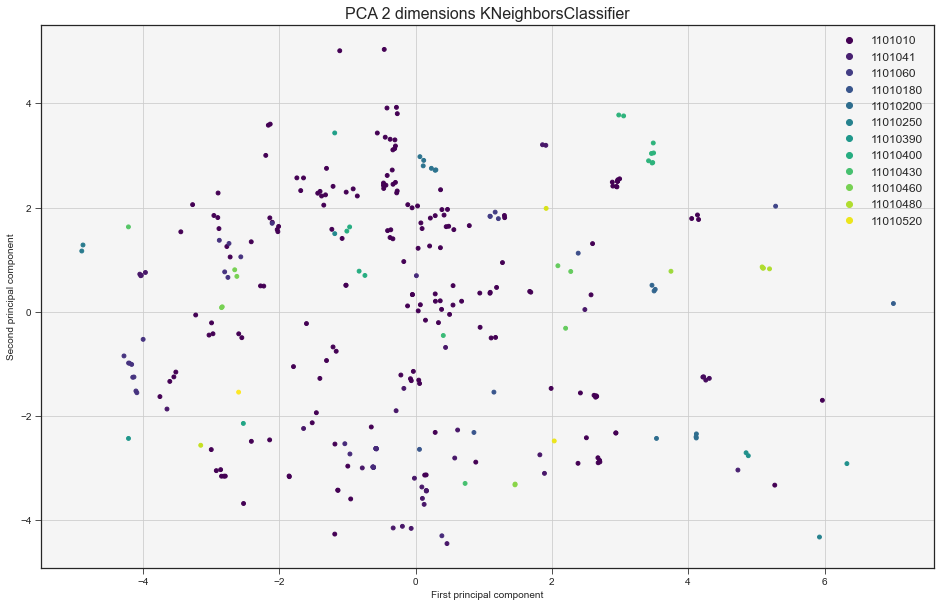

In [43]:
classes=list(np.unique(Pred_y))
font = {
        'size': 16,
        }

pca = PCA(n_components = 2)
pca_res = pca.fit_transform(X_test)

plt.figure(figsize=(16, 10))
plot=plt.scatter(pca_res[:, 0], pca_res[:, 1], c=color, s=15, cmap='viridis')
plt.xlabel('First principal component')
plt.ylabel('Second principal component')
plt.title('PCA 2 dimensions KNeighborsClassifier',fontdict=font)
plt.legend(handles=plot.legend_elements()[0],labels=classes,loc="upper right",fontsize='12')
ax = plt.axes()
plt.style.use('seaborn-ticks')
ax.set_facecolor('whitesmoke')
plt.grid()
plt.show()


In [44]:
pca = PCA(n_components = 3)
data_embedded = pca.fit_transform(X_test)

fig = go.Figure(data=[go.Scatter3d(
    x=data_embedded[:,0],
    y=data_embedded[:,1],
    z=data_embedded[:,2],
    mode='markers',
    marker=dict(
        size=2,
        color = color,
        colorscale = 'Viridis',
        opacity = 0.7
    )
)])

fig.update_layout(scene = dict(
                    xaxis_title='First principal component',
                    yaxis_title='Second principal component',
                    zaxis_title='Third principal component'),
                    margin=dict(r=20, b=10, l=10, t=10))
fig.show()

# Classification Neural Network

We now construct a Neural Network architecture to classify the protein structure. We follow the CATH classification for the first $2$ classes:

- Class Number (**C**)
- Architecture Number (**A**)

**C** $=0,1,2$, i.e. mainly $\alpha$ helix, mainly $\beta$ sheet, and mixed $\alpha\beta$.

We use the features computed with our algorithm, then for the clustering procedure we use the PNAS' features.





In [2]:
'''Importing Data'''

y = np.loadtxt('labels.txt', dtype = str)
path = 'coord_prot.txt'
prot = pd.read_csv(path, header=None)
prot['label'] = y
prot = prot.sort_values(by=['label'],ignore_index=True)
prot = prot.dropna()
prot = prot[prot.label != 'nan']

x = prot[prot.columns[0:15]]
x = np.array(x)
y = prot['label']
y = np.array(y)

In [3]:
'''Cleaning Data'''

x = sigma_clip(x, sigma=3, masked=False, axis=0)
y = y[~np.isnan(x).any(axis=1)]
x = x[~np.isnan(x).any(axis=1)]
print("X shape after truncation: ", x.shape) 
print("y shape after truncation: ", y.shape)

X shape after truncation:  (73772, 15)
y shape after truncation:  (73772,)


# Neural Network for the C class

We want to do a Neural Network for the C class, leaving out the $4$ and $6$ classes because they have very few samples.

In [4]:
y_true = np.zeros(y.shape,dtype=int)
y = y[y != 'nan']
for i in range(len(y)):

    g = y[i].split('.')
    g = g[0]
    y_true[i] = int(g)

In [5]:
_, counts = np.unique(y_true, return_counts = True)
c1 = counts[0]
c2 = c1 + counts[1]
c3 = c2 + counts[2]
c4 = c3 + counts[3]
c6 = c4 + counts[4]

In [6]:
x_1 = x[:c3, :]
y_label = y_true[:c3]
uniqs, counts = np.unique(y_label,return_counts= True)
print("Labels in class C: ", uniqs)
print("Number of proteins in each label: ", counts)

Labels in class C:  [1 2 3]
Number of proteins in each label:  [14498 22318 36588]


In [7]:
'''One hot encode and StandardScaler transformation'''

label_encoder = LabelEncoder()
integer_encoded = label_encoder.fit_transform(y_label)

# Binary encode
onehot_encoder = OneHotEncoder(sparse=False)
integer_encoded = integer_encoded.reshape(len(integer_encoded), 1)
y_label = onehot_encoder.fit_transform(integer_encoded)

x_standard = StandardScaler().fit_transform(x_1)
print('X shape: ', x_standard.shape)
print('y shape: ', y_label.shape)

X shape:  (73404, 15)
y shape:  (73404, 3)


### Neural Network

In order to classify the protein in the class **C**, we build a NN with a input layer of $15$ neurons and a output layer of $3$ neurons, since **C** $= 1,2,3$.

For the hyperparameters of the model, we use the results of a `GridSearch`. In particoular:

- Optimizer = `Adam`
- Activation function = `relu`
- Number of Epochs $= 300$
- Batch Size $= 70$
- Dropout Rate $= 0.2$

In [8]:
X_train, X_test, y_train, y_test = train_test_split(x_standard, y_label, train_size=0.8, random_state = 123)

In [9]:
'''Define some test model'''

def create_model_0(activation='relu',optimizer='adam',dropout_rate=0.2, L = 15):
    # 1 hidden layer
    model = Sequential()
    model.add(Dense(L, input_shape = (L,),activation = activation))
    model.add(Dense(50,activation = activation))
    model.add(Dense(3, activation = 'softmax'))
    print(model.summary())

    # compile model
    model.compile( loss = 'categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])
    
    return model

model0 = create_model_0()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 15)                240       
_________________________________________________________________
dense_1 (Dense)              (None, 50)                800       
_________________________________________________________________
dense_2 (Dense)              (None, 3)                 153       
Total params: 1,193
Trainable params: 1,193
Non-trainable params: 0
_________________________________________________________________
None


## <center>  NN with 1 hidden layer <center>


In [10]:
fit = model0.fit(X_train, y_train,
               epochs = 200, batch_size = 70,
               validation_data = (X_test,y_test),
               shuffle = True)

Train on 58723 samples, validate on 14681 samples
Epoch 1/200
58723/58723 [==============================] - 3s 53us/sample - loss: 0.5124 - accuracy: 0.7805 - val_loss: 0.4617 - val_accuracy: 0.8037
Epoch 2/200
58723/58723 [==============================] - 2s 29us/sample - loss: 0.4506 - accuracy: 0.8052 - val_loss: 0.4441 - val_accuracy: 0.8119
Epoch 3/200
58723/58723 [==============================] - 2s 31us/sample - loss: 0.4379 - accuracy: 0.8126 - val_loss: 0.4351 - val_accuracy: 0.8148
Epoch 4/200
58723/58723 [==============================] - 2s 29us/sample - loss: 0.4293 - accuracy: 0.8169 - val_loss: 0.4276 - val_accuracy: 0.8225
Epoch 5/200
58723/58723 [==============================] - 2s 29us/sample - loss: 0.4202 - accuracy: 0.8222 - val_loss: 0.4167 - val_accuracy: 0.8276
Epoch 6/200
58723/58723 [==============================] - 2s 29us/sample - loss: 0.4099 - accuracy: 0.8284 - val_loss: 0.4081 - val_accuracy: 0.8341
Epoch 7/200
58723/58723 [=========================

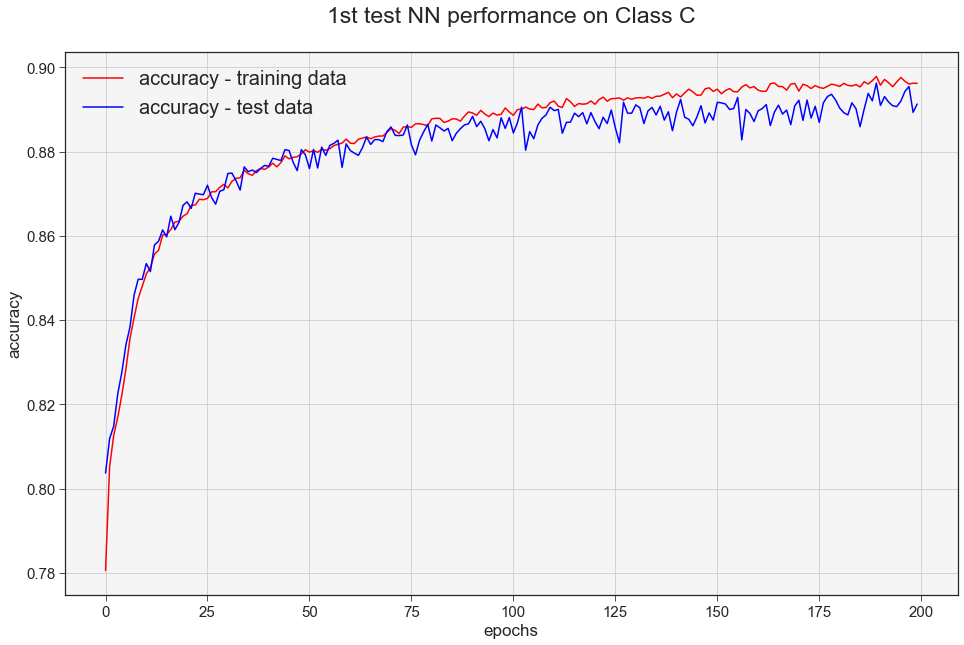

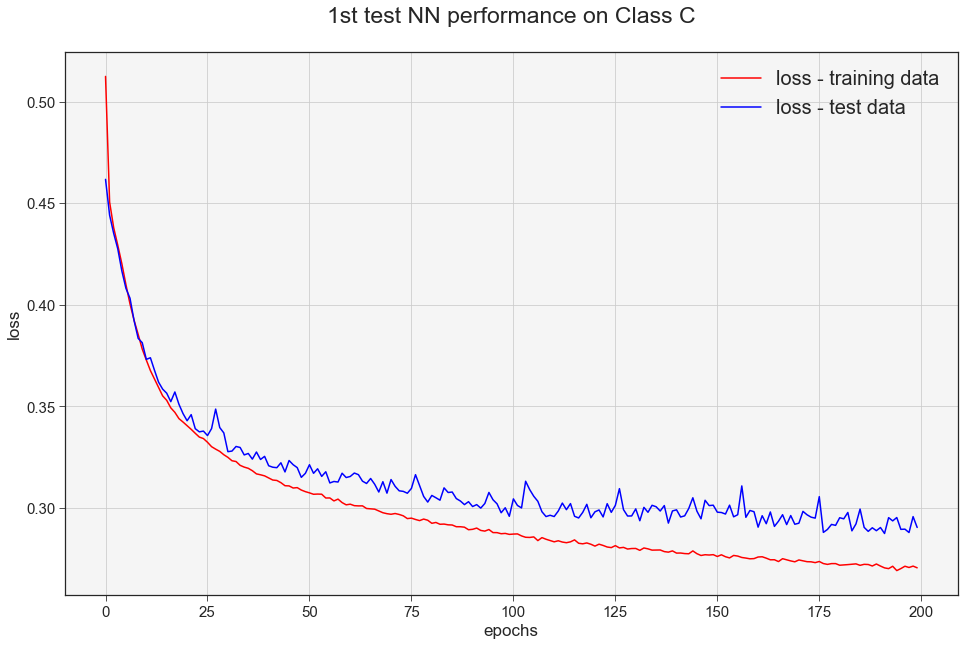

In [11]:
#fig, axs = plt.subplots(1,2, figsize=(16, 10))

for obs in ('accuracy', 'loss'):
    plt.figure(figsize=(16,10))
    plt.style.use('seaborn-ticks')
    plt.plot(fit.history[obs], 'r', label = obs +' - training data')
    plt.plot(fit.history['val_' + obs], 'b', label = obs + ' - test data')
    plt.title('1st test NN performance on Class C\n', fontsize = 23)
    ax = plt.subplot()
    ax.set_facecolor("whitesmoke")
    plt.xlabel('epochs', fontsize = 17)
    plt.ylabel(obs, fontsize = 17)
    plt.legend(loc = "best", fontsize = 20)
    plt.xticks(fontsize = 15)
    plt.yticks(fontsize = 15)
    plt.grid()
    plt.show()

In [12]:
def create_model_1(activation='relu',optimizer='adam',dropout_rate=0.2, L = 15):
    # 2 hidden layer
    model = Sequential()
    model.add(Dense(L, input_shape = (L,),activation = activation))
    model.add(Dense(100,activation = activation))
    model.add(Dense(50,activation = activation))
    model.add(Dense(3, activation = 'softmax'))
    print(model.summary())

    # compile model
    model.compile( loss = 'categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])
    
    return model

model1 = create_model_1()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3 (Dense)              (None, 15)                240       
_________________________________________________________________
dense_4 (Dense)              (None, 100)               1600      
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 3)                 153       
Total params: 7,043
Trainable params: 7,043
Non-trainable params: 0
_________________________________________________________________
None


## <center>  NN with 2 hidden layer <center>

In [13]:
fit = model1.fit(X_train, y_train,
               epochs = 200, batch_size = 70,
               validation_data = (X_test,y_test),
               shuffle = True)

Train on 58723 samples, validate on 14681 samples
Epoch 1/200
58723/58723 [==============================] - 2s 41us/sample - loss: 0.4963 - accuracy: 0.7880 - val_loss: 0.4493 - val_accuracy: 0.8162
Epoch 2/200
58723/58723 [==============================] - 2s 34us/sample - loss: 0.4348 - accuracy: 0.8167 - val_loss: 0.4251 - val_accuracy: 0.8234
Epoch 3/200
58723/58723 [==============================] - 2s 34us/sample - loss: 0.4158 - accuracy: 0.8262 - val_loss: 0.4099 - val_accuracy: 0.8336
Epoch 4/200
58723/58723 [==============================] - 2s 36us/sample - loss: 0.3970 - accuracy: 0.8352 - val_loss: 0.3909 - val_accuracy: 0.8422
Epoch 5/200
58723/58723 [==============================] - 2s 34us/sample - loss: 0.3828 - accuracy: 0.8446 - val_loss: 0.3898 - val_accuracy: 0.8493
Epoch 6/200
58723/58723 [==============================] - 2s 34us/sample - loss: 0.3713 - accuracy: 0.8508 - val_loss: 0.3695 - val_accuracy: 0.8559
Epoch 7/200
58723/58723 [=========================

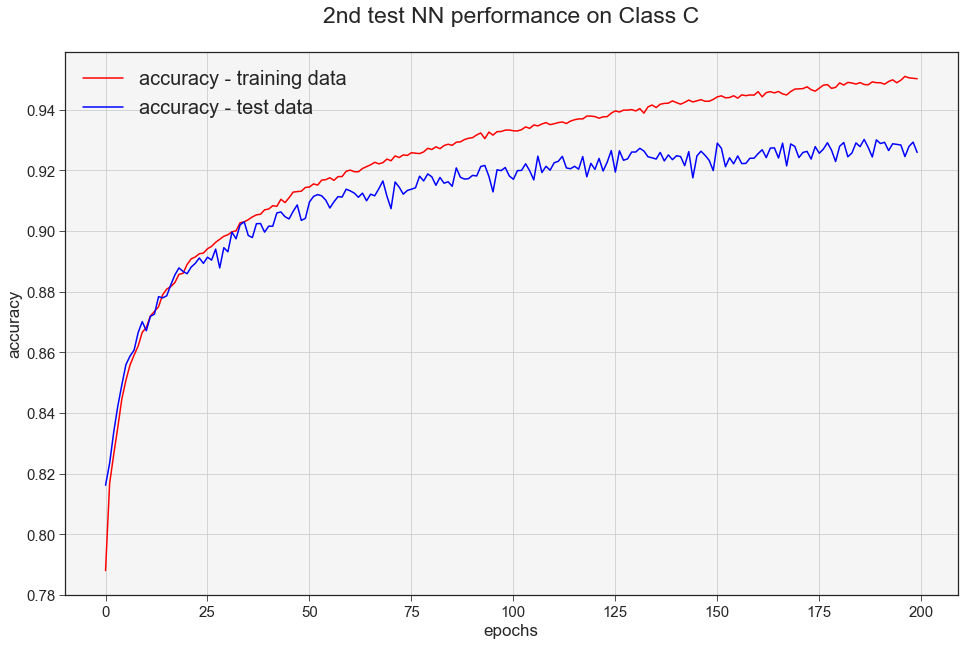

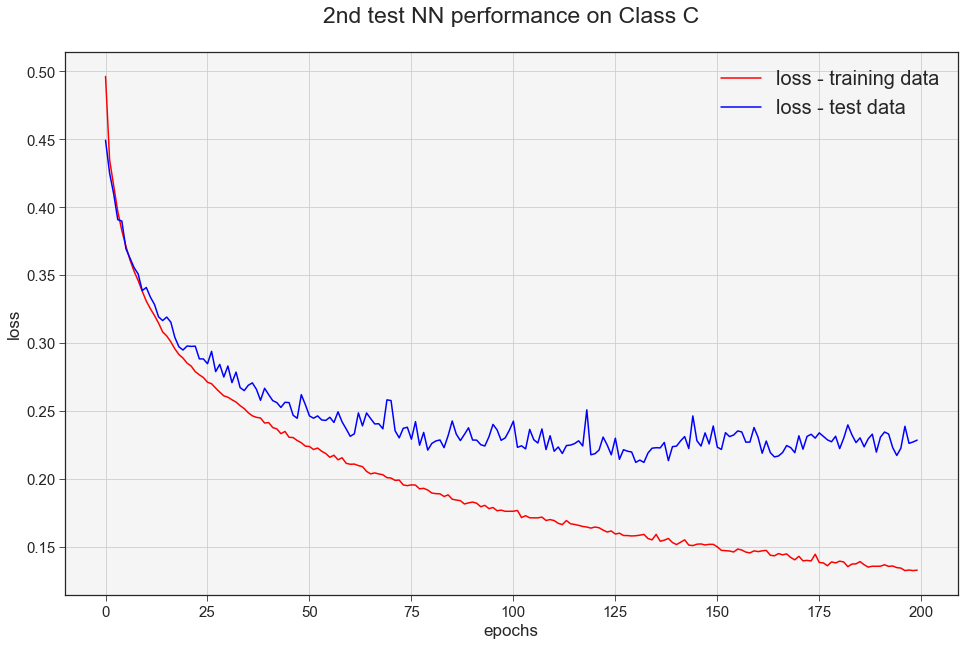

In [14]:

for obs in ('accuracy', 'loss'):
    plt.figure(figsize=(16,10))
    plt.style.use('seaborn-ticks')
    plt.plot(fit.history[obs], 'r', label = obs +' - training data')
    plt.plot(fit.history['val_' + obs], 'b', label = obs + ' - test data')
    plt.title('2nd test NN performance on Class C\n', fontsize = 23)
    ax = plt.subplot()
    ax.set_facecolor("whitesmoke")
    plt.xlabel('epochs', fontsize = 17)
    plt.ylabel(obs, fontsize = 17)
    plt.legend(loc = "best", fontsize = 20)
    plt.xticks(fontsize = 15)
    plt.yticks(fontsize = 15)
    plt.grid()
    plt.show()

In [15]:
def create_model_2(activation='relu',optimizer='adam',dropout_rate=0.2, L = 15):
    # 3 hidden layer
    model = Sequential()
    model.add(Dense(L, input_shape = (L,),activation = activation))
    model.add(Dense(50,activation = activation))
    model.add(Dense(100,activation = activation))
    model.add(Dense(50,activation = activation))
    model.add(Dense(3, activation = 'softmax'))
    print(model.summary())

    # compile model
    model.compile( loss = 'categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])
    
    return model

model2 = create_model_2()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_7 (Dense)              (None, 15)                240       
_________________________________________________________________
dense_8 (Dense)              (None, 50)                800       
_________________________________________________________________
dense_9 (Dense)              (None, 100)               5100      
_________________________________________________________________
dense_10 (Dense)             (None, 50)                5050      
_________________________________________________________________
dense_11 (Dense)             (None, 3)                 153       
Total params: 11,343
Trainable params: 11,343
Non-trainable params: 0
_________________________________________________________________
None


## <center>  NN with 3 hidden layer <center>


In [16]:
fit = model2.fit(X_train, y_train,
               epochs = 200, batch_size = 70,
               validation_data = (X_test,y_test),
               shuffle = True)

Train on 58723 samples, validate on 14681 samples
Epoch 1/200
58723/58723 [==============================] - 3s 43us/sample - loss: 0.4942 - accuracy: 0.7873 - val_loss: 0.4457 - val_accuracy: 0.8146
Epoch 2/200
58723/58723 [==============================] - 2s 38us/sample - loss: 0.4322 - accuracy: 0.8159 - val_loss: 0.4208 - val_accuracy: 0.8281
Epoch 3/200
58723/58723 [==============================] - 2s 36us/sample - loss: 0.4122 - accuracy: 0.8278 - val_loss: 0.4068 - val_accuracy: 0.8356
Epoch 4/200
58723/58723 [==============================] - 2s 36us/sample - loss: 0.3942 - accuracy: 0.8383 - val_loss: 0.3925 - val_accuracy: 0.8436
Epoch 5/200
58723/58723 [==============================] - 2s 36us/sample - loss: 0.3813 - accuracy: 0.8451 - val_loss: 0.3795 - val_accuracy: 0.8510
Epoch 6/200
58723/58723 [==============================] - 2s 36us/sample - loss: 0.3708 - accuracy: 0.8512 - val_loss: 0.3719 - val_accuracy: 0.8553
Epoch 7/200
58723/58723 [=========================

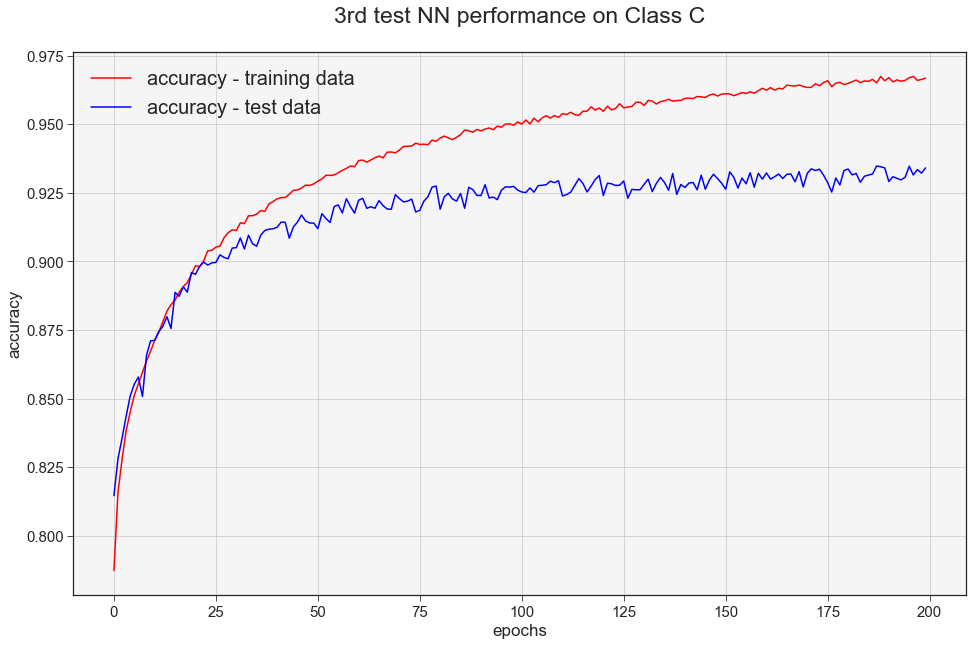

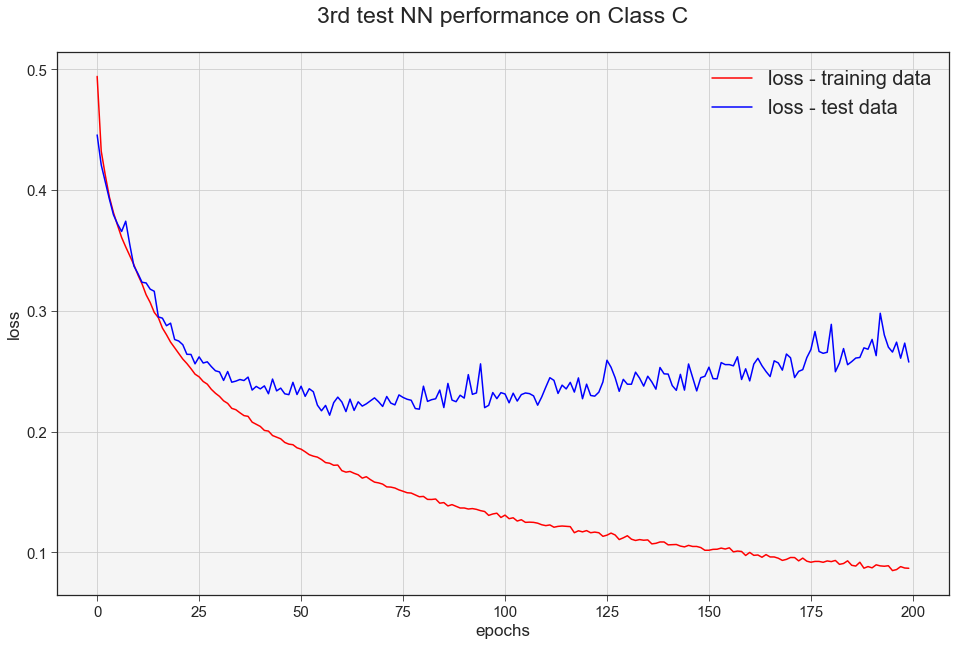

In [17]:

for obs in ('accuracy', 'loss'):
    plt.figure(figsize=(16,10))
    plt.style.use('seaborn-ticks')
    plt.plot(fit.history[obs], 'r', label = obs +' - training data')
    plt.plot(fit.history['val_' + obs], 'b', label = obs + ' - test data')
    plt.title('3rd test NN performance on Class C\n', fontsize = 23)
    ax = plt.subplot()
    ax.set_facecolor("whitesmoke")
    plt.xlabel('epochs', fontsize = 17)
    plt.ylabel(obs, fontsize = 17)
    plt.legend(loc = "best", fontsize = 20)
    plt.xticks(fontsize = 15)
    plt.yticks(fontsize = 15)
    plt.grid()
    plt.show()

In [18]:
def create_model(activation='relu',optimizer='adam',dropout_rate=0.2, L = 15):
    # Best Model
    model = Sequential()
    model.add(Dense(L, input_shape = (L,),activation = activation))
    model.add(Dense(150,activation = activation))

    model.add(Dropout(dropout_rate))
    model.add(Dense(100,activation = activation))
    model.add(Dense(70,activation = activation))
    
    model.add(Dropout(dropout_rate))
    model.add(Dense(30,activation = activation))
    model.add(Dense(3, activation = 'softmax'))
    print(model.summary())

    # compile model
    model.compile( loss = 'categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])
     
    return model

model = create_model()



Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_12 (Dense)             (None, 15)                240       
_________________________________________________________________
dense_13 (Dense)             (None, 150)               2400      
_________________________________________________________________
dropout (Dropout)            (None, 150)               0         
_________________________________________________________________
dense_14 (Dense)             (None, 100)               15100     
_________________________________________________________________
dense_15 (Dense)             (None, 70)                7070      
_________________________________________________________________
dropout_1 (Dropout)          (None, 70)                0         
_________________________________________________________________
dense_16 (Dense)             (None, 30)               

## <center>  NN with 4 hidden layer <center>



In [19]:

fit = model.fit(X_train, y_train,
               epochs = 300, batch_size = 70,
               validation_data = (X_test,y_test),
               shuffle = True)

Train on 58723 samples, validate on 14681 samples
Epoch 1/300
58723/58723 [==============================] - 3s 51us/sample - loss: 0.5005 - accuracy: 0.7867 - val_loss: 0.4492 - val_accuracy: 0.8072
Epoch 2/300
58723/58723 [==============================] - 2s 39us/sample - loss: 0.4415 - accuracy: 0.8117 - val_loss: 0.4215 - val_accuracy: 0.8239
Epoch 3/300
58723/58723 [==============================] - 2s 39us/sample - loss: 0.4232 - accuracy: 0.8222 - val_loss: 0.4063 - val_accuracy: 0.8333
Epoch 4/300
58723/58723 [==============================] - 2s 42us/sample - loss: 0.4054 - accuracy: 0.8325 - val_loss: 0.3864 - val_accuracy: 0.8436
Epoch 5/300
58723/58723 [==============================] - 2s 39us/sample - loss: 0.3904 - accuracy: 0.8417 - val_loss: 0.3767 - val_accuracy: 0.8545
Epoch 6/300
58723/58723 [==============================] - 2s 41us/sample - loss: 0.3771 - accuracy: 0.8475 - val_loss: 0.3628 - val_accuracy: 0.8563
Epoch 7/300
58723/58723 [=========================

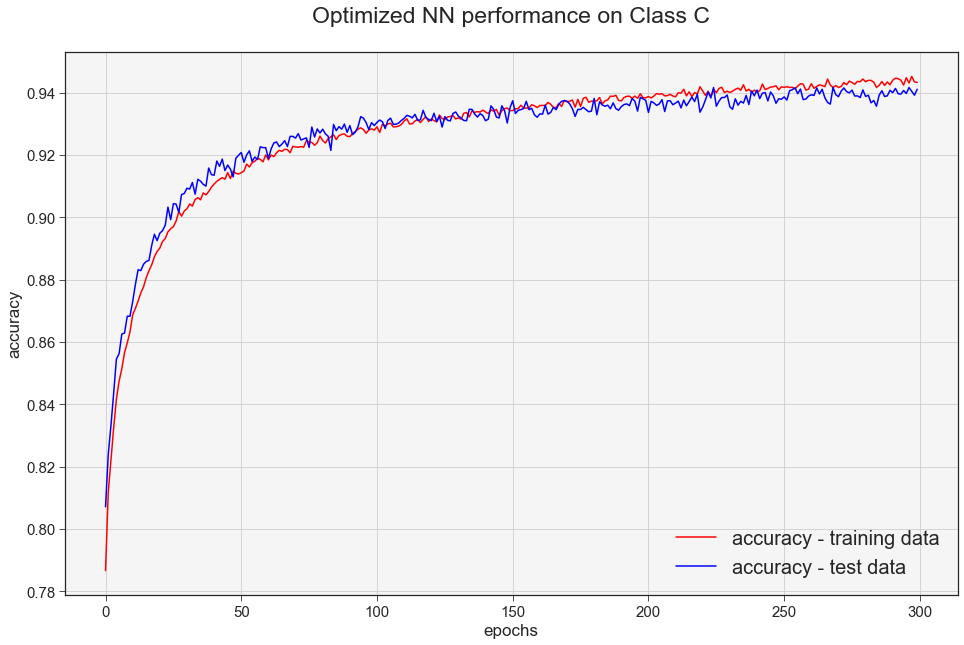

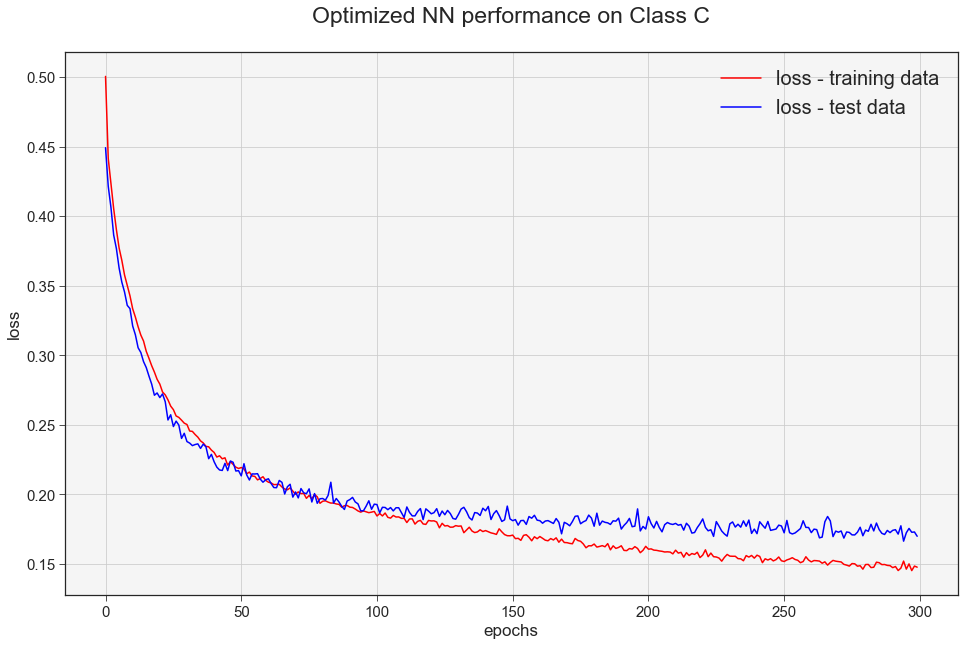

In [20]:
for obs in ('accuracy', 'loss'):
    plt.figure(figsize=(16,10))
    plt.style.use('seaborn-ticks')
    plt.plot(fit.history[obs], 'r', label = obs +' - training data')
    plt.plot(fit.history['val_' + obs], 'b', label = obs + ' - test data')
    plt.title('Optimized NN performance on Class C\n', fontsize = 23) 
    ax = plt.subplot()
    ax.set_facecolor("whitesmoke")
    plt.xlabel('epochs', fontsize = 17)
    plt.ylabel(obs, fontsize = 17)
    plt.legend(loc = "best", fontsize = 20)
    plt.xticks(fontsize = 15)
    plt.yticks(fontsize = 15)
    plt.grid()
    plt.show()

# Neural Network for class A ($\alpha$ helix)

There are $29295$ $\alpha$ helix proteins, (Class **C** $=1$), for which we have $5$ labels in class **A**. 


In [21]:
y_true = np.zeros(y.shape,dtype=int)
y = y[y != 'nan']
for i in range(len(y)):

    g = y[i].split('.')
    g = g[0] + g[1]
    y_true[i] = int(g)

In [22]:
x_1 = x[:c1, :]
y_label = y_true[:c1]
uniqs, counts = np.unique(y_label, return_counts= True)
print("Labels in class C = 1: ", uniqs)
print("Number of proteins in each label: ", counts)

Labels in class C = 1:  [110 120 125 140 150]
Number of proteins in each label:  [11204  2876   269     2   147]


In [23]:
label_encoder = LabelEncoder()
integer_encoded = label_encoder.fit_transform(y_label)

# Binary encode
onehot_encoder = OneHotEncoder(sparse=False)
integer_encoded = integer_encoded.reshape(len(integer_encoded), 1)
y_label = onehot_encoder.fit_transform(integer_encoded)

x_standard = StandardScaler().fit_transform(x_1)
print('X shape: ', x_standard.shape)
print('y shape: ', y_label.shape)

X shape:  (14498, 15)
y shape:  (14498, 5)


In [24]:
X_train, X_test, y_train, y_test = train_test_split(x_standard, y_label, train_size=0.8, random_state = 123)

### Neural Network

The architecture of the model is similar to the previous one, but here we have about $15000$ samples. 

So we reduce the number of neurons in the hidden layers, to avoid overfitting.

In [25]:
def create_model_2(activation='relu',optimizer='adam',dropout_rate=0.2, L = 15):
    # create model
    model = Sequential()
    model.add(Dense(L, input_shape = (L,),activation = activation))
    model.add(Dense(50,activation = activation))
    
    model.add(Dropout(dropout_rate))
    model.add(Dense(70,activation = activation))
    
    model.add(Dropout(dropout_rate))
    model.add(Dense(30,activation = activation))
    model.add(Dense(5, activation = 'softmax'))
    print(model.summary())

    # compile model
    model.compile( loss = 'categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])
    
    return model
model_2 = create_model_2()


Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_18 (Dense)             (None, 15)                240       
_________________________________________________________________
dense_19 (Dense)             (None, 50)                800       
_________________________________________________________________
dropout_2 (Dropout)          (None, 50)                0         
_________________________________________________________________
dense_20 (Dense)             (None, 70)                3570      
_________________________________________________________________
dropout_3 (Dropout)          (None, 70)                0         
_________________________________________________________________
dense_21 (Dense)             (None, 30)                2130      
_________________________________________________________________
dense_22 (Dense)             (None, 5)                

In [26]:
model_2 = create_model_2()

fit = model_2.fit(X_train, y_train,
               epochs = 300, batch_size = 50,
               validation_data = (X_test,y_test),
               shuffle = True)

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_23 (Dense)             (None, 15)                240       
_________________________________________________________________
dense_24 (Dense)             (None, 50)                800       
_________________________________________________________________
dropout_4 (Dropout)          (None, 50)                0         
_________________________________________________________________
dense_25 (Dense)             (None, 70)                3570      
_________________________________________________________________
dropout_5 (Dropout)          (None, 70)                0         
_________________________________________________________________
dense_26 (Dense)             (None, 30)                2130      
_________________________________________________________________
dense_27 (Dense)             (None, 5)                

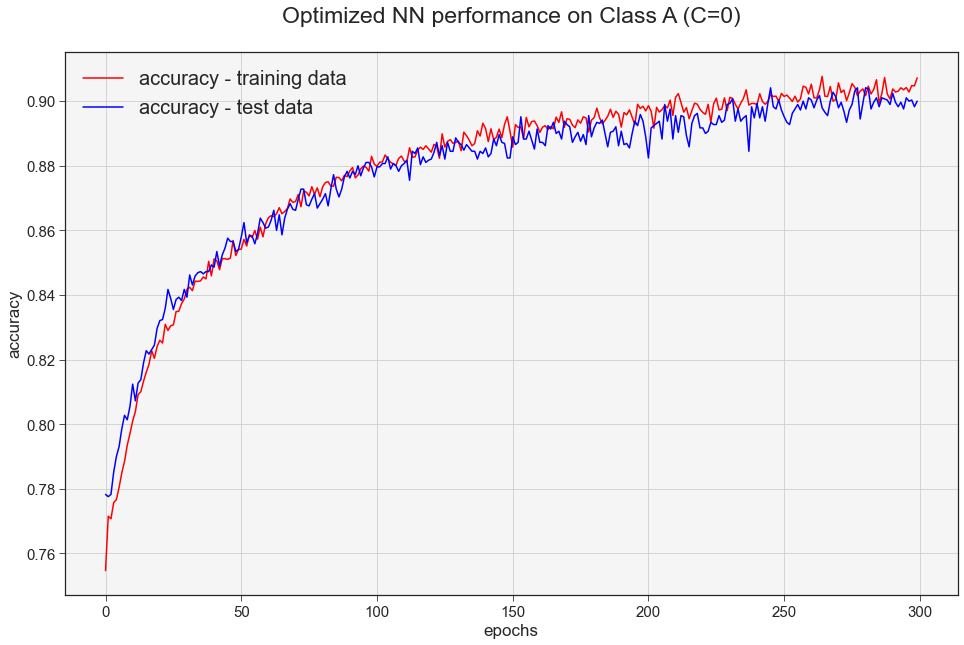

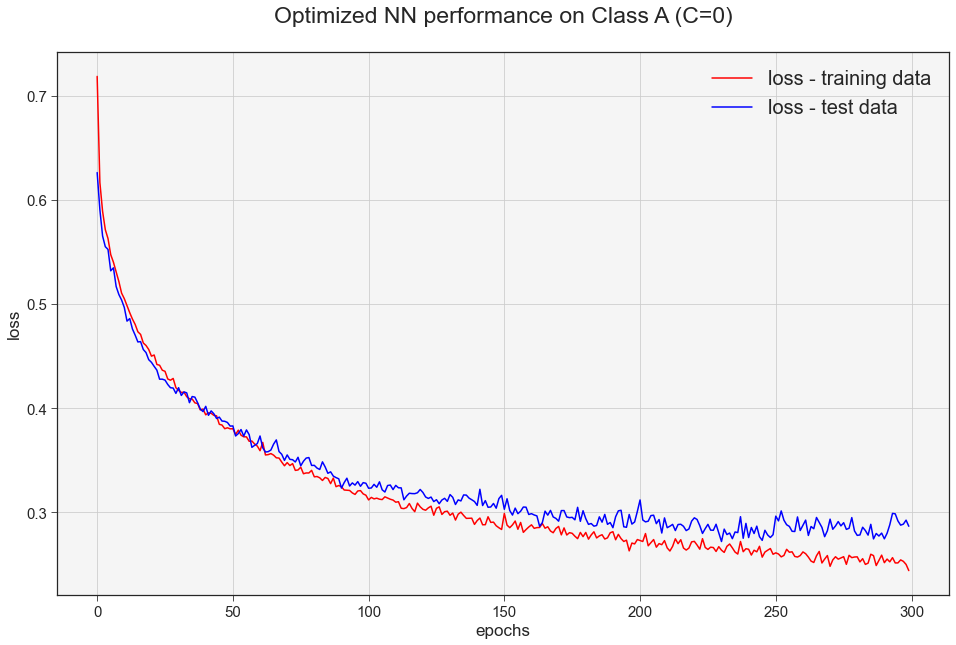

In [27]:
for obs in ('accuracy', 'loss'):
    plt.figure(figsize=(16,10))
    plt.style.use('seaborn-ticks')
    plt.plot(fit.history[obs], 'r', label = obs +' - training data')
    plt.plot(fit.history['val_' + obs], 'b', label = obs + ' - test data')
    plt.title('Optimized NN performance on Class A (C=0)\n', fontsize = 23)
    ax = plt.subplot()
    ax.set_facecolor("whitesmoke")
    plt.xlabel('epochs', fontsize = 17)
    plt.ylabel(obs, fontsize = 17)
    plt.legend(loc = "best", fontsize = 20)
    plt.xticks(fontsize = 15)
    plt.yticks(fontsize = 15)
    plt.grid()
    plt.show()

# Neural Network for class A ($\beta$ sheet)

There are $22318$ $\beta$ sheet proteins, (Class **C** $=2$), for which we have $20$ labels in class **A**. But under some labels there are very few elements, so we neglect those categories.

We end up with $21995$ and $11$ labels.

In [28]:
x_1 = x[c1:c2, :]
y_label = y_true[c1:c2]
uniqs, counts = np.unique(y_label, return_counts= True)
print("Labels in class C = 2: ", uniqs)
print("Number of proteins in each label: ", counts)

Labels in class C = 2:  [ 210  220  230  240  250  260  270  280  290 2100 2102 2110 2115 2120
 2130 2140 2150 2160 2170]
Number of proteins in each label:  [  920   297  1962  5990    30 10500   761   358    41    90    63    15
    60   311   292    11    13   308   296]


In [29]:
cancel = [2180, 2150, 2140, 2115, 2110, 2102, 2100, 290, 250]
cancel.sort()

i_idx = []
for can in cancel:
    for i in range(len(y_label)):
        if y_label[i] == can:
            i_idx.append(i)
y_label = np.delete(y_label, i_idx)
x_1 = np.delete(x_1, i_idx,0)

In [30]:
label_encoder = LabelEncoder()
integer_encoded = label_encoder.fit_transform(y_label)

# Binary encode
onehot_encoder = OneHotEncoder(sparse=False)
integer_encoded = integer_encoded.reshape(len(integer_encoded), 1)
y_label = onehot_encoder.fit_transform(integer_encoded)

x_standard = StandardScaler().fit_transform(x_1)
print('X shape: ', x_standard.shape)
print('y shape: ', y_label.shape)

X shape:  (21995, 15)
y shape:  (21995, 11)


In [31]:
X_train, X_test, y_train, y_test = train_test_split(x_standard, y_label, train_size=0.8, random_state = 123)

### Neural Network

Here we adapt again the architecture of the network in order to find the best results for $22000$ samples.

In [32]:
def create_model_3(activation='relu',optimizer='adam',dropout_rate=0.1, L = 15):
    # create model
    model = Sequential()
    model.add(Dense(L, input_shape = (L,),activation = activation))
    model.add(Dense(50,activation = activation))
    
    model.add(Dropout(dropout_rate))
    
    model.add(Dense(100,activation = activation))
    model.add(Dense(50,activation = activation))
    
    model.add(Dropout(dropout_rate))
    model.add(Dense(30,activation = activation))
    model.add(Dense(11, activation = 'softmax'))
    print(model.summary())

    # compile model
    model.compile( loss = 'categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])
    
    return model
model_3 = create_model_3()


Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_28 (Dense)             (None, 15)                240       
_________________________________________________________________
dense_29 (Dense)             (None, 50)                800       
_________________________________________________________________
dropout_6 (Dropout)          (None, 50)                0         
_________________________________________________________________
dense_30 (Dense)             (None, 100)               5100      
_________________________________________________________________
dense_31 (Dense)             (None, 50)                5050      
_________________________________________________________________
dropout_7 (Dropout)          (None, 50)                0         
_________________________________________________________________
dense_32 (Dense)             (None, 30)               

In [33]:
model_3 = create_model_3()

fit = model_3.fit(X_train, y_train,
               epochs = 300, batch_size = 50,
               validation_data = (X_test,y_test),
               shuffle = True)

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_34 (Dense)             (None, 15)                240       
_________________________________________________________________
dense_35 (Dense)             (None, 50)                800       
_________________________________________________________________
dropout_8 (Dropout)          (None, 50)                0         
_________________________________________________________________
dense_36 (Dense)             (None, 100)               5100      
_________________________________________________________________
dense_37 (Dense)             (None, 50)                5050      
_________________________________________________________________
dropout_9 (Dropout)          (None, 50)                0         
_________________________________________________________________
dense_38 (Dense)             (None, 30)               

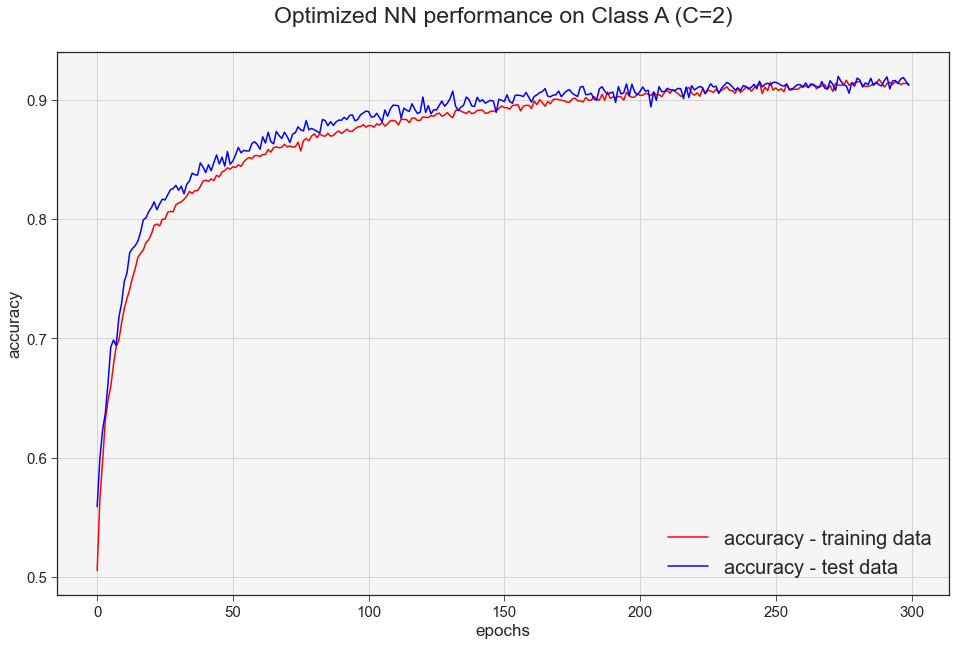

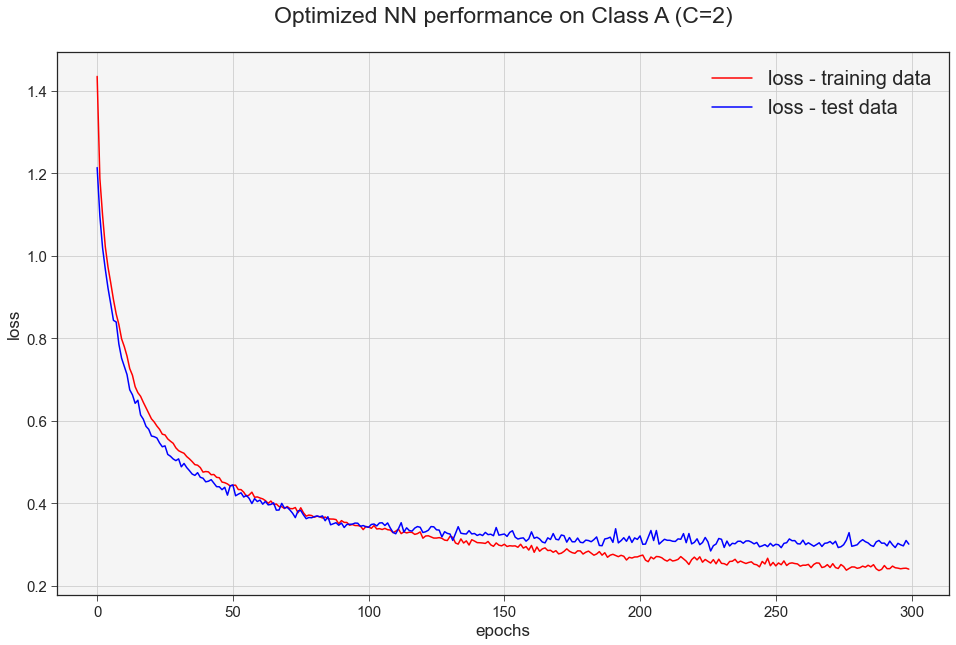

In [34]:
for obs in ('accuracy', 'loss'):
    plt.figure(figsize=(16,10))
    plt.style.use('seaborn-ticks')
    plt.plot(fit.history[obs], 'r', label = obs +' - training data')
    plt.plot(fit.history['val_' + obs], 'b', label = obs + ' - test data')
    plt.title('Optimized NN performance on Class A (C=2)\n', fontsize = 23)
    ax = plt.subplot()
    ax.set_facecolor("whitesmoke")
    plt.xlabel('epochs', fontsize = 17)
    plt.ylabel(obs, fontsize = 17)
    plt.legend(loc = "best", fontsize = 20)
    plt.xticks(fontsize = 15)
    plt.yticks(fontsize = 15)
    plt.grid()
    plt.show()

# Neural Network for class A ($\alpha\beta$ )

There are $36588$ $\alpha\beta$  proteins, (Class **C** $=3$), for which we have $15$ labels in class **A**. But under some labels there are very few elements, so we neglict those categories.

We end up with $36365$ and $8$ labels.

In [35]:
x_1 = x[c2:c3, :]
y_label = y_true[c2:c3]
uniqs, counts = np.unique(y_label, return_counts= True)
print("Labels in class C = 3: ", uniqs)
print("Number of proteins in each label: ", counts)

Labels in class C = 3:  [ 310  315  320  330  340  350  355  360  365  370  375  380  390 3100]
Number of proteins in each label:  [ 3628     7  3691  8444 15762   318    11  1299    71    61    42   108
  3115    31]


In [36]:
cancel = [315, 355,365,  370,  375, 3100]
cancel.sort()

i_idx = []
for can in cancel:
    for i in range(len(y_label)):
        if y_label[i] == can:
            i_idx.append(i)
y_label = np.delete(y_label, i_idx)
x_1 = np.delete(x_1, i_idx,0)

In [37]:
label_encoder = LabelEncoder()
integer_encoded = label_encoder.fit_transform(y_label)

# Binary encode
onehot_encoder = OneHotEncoder(sparse=False)
integer_encoded = integer_encoded.reshape(len(integer_encoded), 1)
y_label = onehot_encoder.fit_transform(integer_encoded)

x_standard = StandardScaler().fit_transform(x_1)
print('X shape: ', x_standard.shape)
print('y shape: ', y_label.shape)

X shape:  (36365, 15)
y shape:  (36365, 8)


### Neural Network

In [38]:
X_train, X_test, y_train, y_test = train_test_split(x_standard, y_label, train_size=0.8, random_state = 123)

In [39]:
def create_model_4(activation='relu',optimizer='adam',dropout_rate=0.1, L = 15):
    # create model
    model = Sequential()
    model.add(Dense(L, input_shape = (L,),activation = activation))
    model.add(Dense(70,activation = activation))
    
    model.add(Dropout(dropout_rate))
    
    model.add(Dense(100,activation = activation))
    model.add(Dense(50,activation = activation))
    
    model.add(Dropout(dropout_rate))
    model.add(Dense(30,activation = activation))
    model.add(Dense(8, activation = 'softmax'))
    print(model.summary())

    # compile model
    model.compile( loss = 'categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])
    
    return model
model_4 = create_model_4()


Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_40 (Dense)             (None, 15)                240       
_________________________________________________________________
dense_41 (Dense)             (None, 70)                1120      
_________________________________________________________________
dropout_10 (Dropout)         (None, 70)                0         
_________________________________________________________________
dense_42 (Dense)             (None, 100)               7100      
_________________________________________________________________
dense_43 (Dense)             (None, 50)                5050      
_________________________________________________________________
dropout_11 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_44 (Dense)             (None, 30)               

In [40]:

fit = model_4.fit(X_train, y_train,
               epochs = 300, batch_size = 50,
               validation_data = (X_test,y_test),
               shuffle = True)

Train on 29092 samples, validate on 7273 samples
Epoch 1/300
29092/29092 [==============================] - 2s 72us/sample - loss: 1.2835 - accuracy: 0.5306 - val_loss: 1.1011 - val_accuracy: 0.5812
Epoch 2/300
29092/29092 [==============================] - 2s 54us/sample - loss: 1.0803 - accuracy: 0.5840 - val_loss: 1.0162 - val_accuracy: 0.6081
Epoch 3/300
29092/29092 [==============================] - 2s 54us/sample - loss: 1.0076 - accuracy: 0.6135 - val_loss: 0.9623 - val_accuracy: 0.6307
Epoch 4/300
29092/29092 [==============================] - 2s 54us/sample - loss: 0.9502 - accuracy: 0.6382 - val_loss: 0.9065 - val_accuracy: 0.6559
Epoch 5/300
29092/29092 [==============================] - 2s 54us/sample - loss: 0.9031 - accuracy: 0.6601 - val_loss: 0.8591 - val_accuracy: 0.6836
Epoch 6/300
29092/29092 [==============================] - 2s 60us/sample - loss: 0.8718 - accuracy: 0.6780 - val_loss: 0.8408 - val_accuracy: 0.6816
Epoch 7/300
29092/29092 [==========================

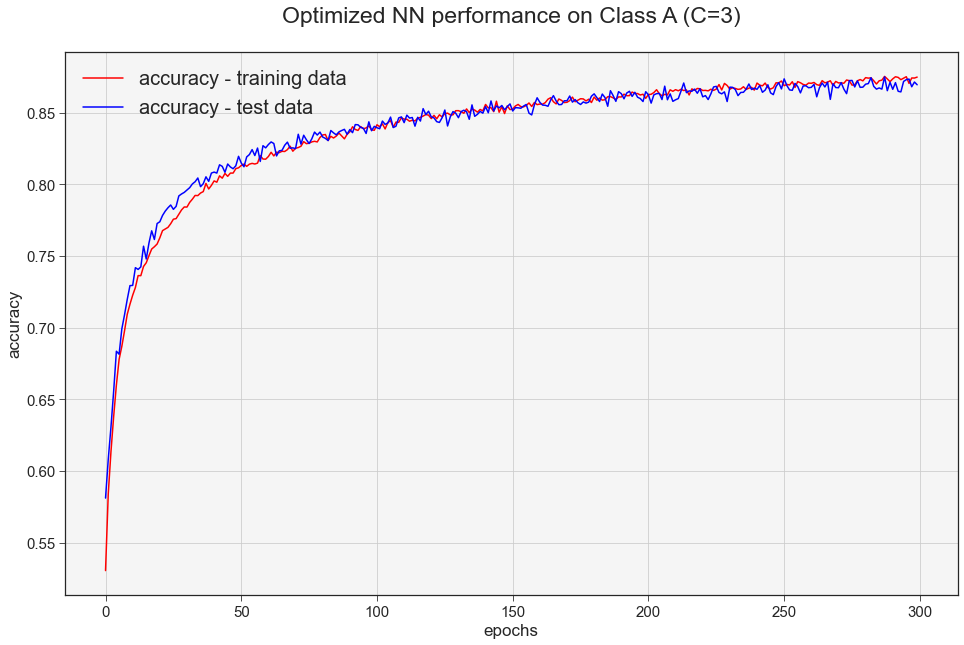

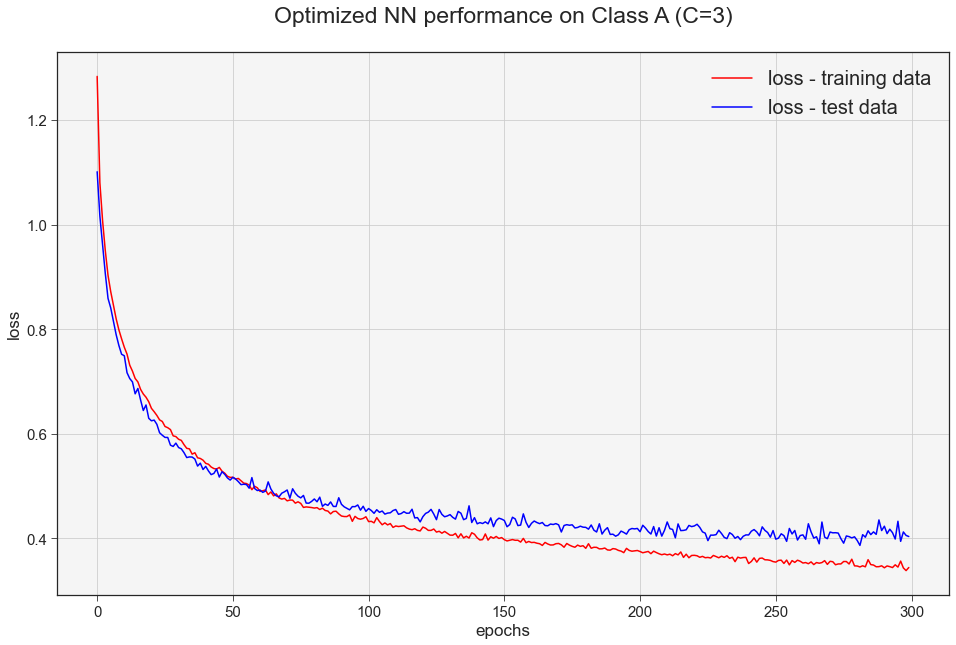

In [41]:
for obs in ('accuracy', 'loss'):
    plt.figure(figsize=(16,10))
    plt.style.use('seaborn-ticks')
    plt.plot(fit.history[obs], 'r', label = obs +' - training data')
    plt.plot(fit.history['val_' + obs], 'b', label = obs + ' - test data')
    plt.title('Optimized NN performance on Class A (C=3)\n', fontsize = 23)
    ax = plt.subplot()
    ax.set_facecolor("whitesmoke")
    plt.xlabel('epochs', fontsize = 17)
    plt.ylabel(obs, fontsize = 17)
    plt.legend(loc = "best", fontsize = 20)
    plt.xticks(fontsize = 15)
    plt.yticks(fontsize = 15)
    plt.grid()
    plt.show()

# Conclusions 
 
- We have seen how to compute the features we have defined. Their computation is faster than the one of those used in the paper we have been referring to. 
- We have tried to clustering our dataset using DBSCAN and KNeighborsClassifier. DBSCAN is not able to recognize the $3$ C clusters. This is because it is a density-based clustering and in our case, after we projected the data into 2D plane, we have just one big cloud of points. On the other hand, KNeighborsClassifier performs better (reaching a score of about $80$%), in according to the original classification method used in the paper. 
- We used the original classification algorithm of the paper (`KNeighborsClassifier`) and original features. We have explored the whole CATH classification and we achieve optimal results. 
- We decided to implement a Neural Network using the features we have defined. This because, even if they are less accurate in the classification w.r.t. the original features, they are so much faster to compute, we obtain good results with different architectures and also the training phase of the NN is very fast.

We have seen that the protein chains are very easy to classify using features based on Gaussian Integrals and topological invariant. This should make faster the process of identify and classify new chains, since using KNeighborsClassifier we reach a score very close to $1$. 
 
On the other hand, even if the features identify by our own have not topological meaning, they represents nearest and nearest couple segments (of the chain) interaction.